 <a href="#Pickle">Link to load data via Pickle</a>

## Coursera Project / Task description
Now that you have been equipped with the skills and the tools to use location data to explore a geographical location, over the course of two weeks, you will have the opportunity to be as creative as you want and come up with an idea to leverage the Foursquare location data to explore or compare neighborhoods or cities of your choice or to come up with a problem that you can use the Foursquare location data to solve. If you cannot think of an idea or a problem, here are some ideas to get you started:

1. In Module 3, we explored New York City and the city of Toronto and segmented and clustered their neighborhoods. Both cities are very diverse and are the financial capitals of their respective countries. One interesting idea would be to compare the neighborhoods of the two cities and determine how similar or dissimilar they are. Is New York City more like Toronto or Paris or some other multicultural city? I will leave it to you to refine this idea.
2. In a city of your choice, if someone is looking to open a restaurant, where would you recommend that they open it? Similarly, if a contractor is trying to start their own business, where would you recommend that they setup their office?
   These are just a couple of many ideas and problems that can be solved using location data in addition to other datasets. No matter what you decide to do, make sure to provide sufficient justification of why you think what you want to do or solve is      important and why would a client or a group of people be interested in your project.
### Review criteria  

This capstone project will be graded by your peers. This capstone project is worth 70% of your total grade. The project will be completed over the course of 2 weeks. Week 1 submissions will be worth 30% whereas week 2 submissions will be worth 40% of your total grade.
For this week, you will required to submit the following:
- A description of the problem and a discussion of the background. (15 marks
- A description of the data and how it will be used to solve the problem. (15 marks)

### For the second week, the final deliverables of the project will be:
    1. A link to your Notebook on your Github repository, showing your code. (15 marks)
    2. A full report consisting of all of the following components (15 marks):
    3. Introduction where you discuss the business problem and who would be interested in this project.
    4. Data where you describe the data that will be used to solve the problem and the source of the data.
    5. Methodology section which represents the main component of the report where you discuss and describe any exploratory data analysis that you did, any inferential statistical testing that you performed, if any, and what machine learnings were used and why.
    6. Results section where you discuss the results.
    7. Discussion section where you discuss any observations you noted and any recommendations you can make based on the results.
    8. Conclusion section where you conclude the report.
3. Your choice of a presentation or blogpost. (10 marks)

<hr>

# Suitability Analysis: 
#   Where are the most suitable Cities to open and maintain Vegetarien Restaurants

# Please note:
This Juypter notebook contains the code related to the Reporting and Project description available at github for week 4 and 5 of the Capstone project.
==> This notebook does not contain the very basic description and overview.


## 1. Goal
    The aim of this project is to estimate the risk for a restaurant chain to build up vegetarian restaurants.
    The levels should be show risk levels, starting with risk-level 1 which represents the most promising location being successfull.
    The risk level 5 represents the highest risk and represents the least promising location being successful
    The risk levels s
## 2. Methods to be applied
    2.1 Data types and sources
        - Federal States of Germany: http://www.statistikportal.de/de/bevoelkerung/flaeche-und-bevoelkerung
        
    2.2 This project is applied on the top 700 German cities from cities with most citizens (Berlin= Capital) down to cities with at least 20.000 citicens.
    2.3. The algorithm to figure out the best locations will include separate steps
    a) locate the top 700 cities of Germany. Provide a rough overview about the areas of high citizen density.
    b) load the existing vegetarian restaurants for each city with a maximum radius of 3000m.

## Data Provisioning and Cleaning


###  Basic population and area data of Germany´s Federal States (16) 

In [167]:
import pandas as pd
import numpy as np
#Get the Federal States of Germany via Wikipedia. Use pandas for html read
df_fds_html=pd.read_html('http://www.statistikportal.de/de/bevoelkerung/flaeche-und-bevoelkerung',thousands=None)

In [100]:
df_fds_raw=df_fds_html[0].copy() # the table is at index 0 of df_fds
df_fds_raw

,0,1,2,3,4,5
0,Bundesland,31.12.2018,31.12.2018,31.12.2018,31.12.2018,31.12.2018
1,Bundesland,Fläche 1),Bevölkerung 2),Bevölkerung 2),Bevölkerung 2),Bevölkerung 2)
2,Bundesland,Fläche 1),insgesamt,männlich,weiblich,je km2
3,Bundesland,km²,Anzahl,Anzahl,Anzahl,Anzahl
4,Baden-Württemberg,"35 748,22",11 069 533,5 501 693,5 567 840,310
5,Bayern,"70 541,57",13 076 721,6 483 793,6 592 928,185
6,Berlin,"891,12",3 644 826,1 792 801,1 852 025,4 090
7,Brandenburg,"29 654,48",2 511 917,1 239 460,1 272 457,85
8,Bremen,"419,36",682 986,338 035,344 951,1 629
9,Hamburg,"755,09",1 841 179,902 048,939 131,2 438


In [101]:
#check the structure and find rows with Null/NaN values
print(df_fds_raw.info())
print ("Rows with Null", df_fds_raw[df_fds_raw.isnull().any(axis=1)])


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 6 columns):
0    21 non-null object
1    21 non-null object
2    21 non-null object
3    21 non-null object
4    21 non-null object
5    21 non-null object
dtypes: object(6)
memory usage: 1.1+ KB
None
Rows with Null Empty DataFrame
Columns: [0, 1, 2, 3, 4, 5]
Index: []


==> All fields are treated as strings. All Features need to be converted to numeric types (float), but before we need to clean the table

In [102]:
# row 0 to 3 and 20 can be deleted as it contains Metadata or summary (line 20) about the data source.
# line 3 represents the column names. Translation to English: "Name_of_state, area_sqkm, citizens_overall,citizens_male,citizens_female,population_density"
fds_col=['Name_of_state', 'area_sqkm', 'citizens_overall','citizens_male','citizens_female','population_density']
fds_col_numeric=['area_sqkm', 'citizens_overall','citizens_male','citizens_female','population_density']
df_fds_raw1=df_fds_raw.copy()
df_fds_raw1.columns=['Name_of_state', 'area_sqkm', 'citizens_overall','citizens_male','citizens_female','population_density']
df_fds_raw1.drop([0,1,2,3,20],inplace=True)
df_fds_raw1.reset_index(drop=True,inplace=True)
df_fds_raw1



,Name_of_state,area_sqkm,citizens_overall,citizens_male,citizens_female,population_density
0,Baden-Württemberg,"35 748,22",11 069 533,5 501 693,5 567 840,310
1,Bayern,"70 541,57",13 076 721,6 483 793,6 592 928,185
2,Berlin,"891,12",3 644 826,1 792 801,1 852 025,4 090
3,Brandenburg,"29 654,48",2 511 917,1 239 460,1 272 457,85
4,Bremen,"419,36",682 986,338 035,344 951,1 629
5,Hamburg,"755,09",1 841 179,902 048,939 131,2 438
6,Hessen,"21 115,68",6 265 809,3 093 044,3 172 765,297
7,Mecklenburg-Vorpommern,"23 294,62",1 609 675,793 639,816 036,69
8,Niedersachsen,"47 709,50",7 982 448,3 943 243,4 039 205,167
9,Nordrhein-Westfalen,"34 112,31",17 932 651,8 798 631,9 134 020,526


In [104]:
# looks like pandas does not recognize numeric data containing spaces and ","
#df_fds['area_sqkm']=pd.to_numeric(df_fds['area_sqkm'])
df_fds=df_fds_raw1.copy()
for col in fds_col_numeric:
    print ("replacing col:",col)
    df_fds[col]=df_fds_raw1[col].str.replace(',','.')
    df_fds[col]=df_fds[col].str.replace(' ','').astype(float)
    
#df_fds=df_fds.infer_objects() =this does still not work but the astype(float) convert to float.
df_fds.info()

replacing col: area_sqkm
replacing col: citizens_overall
replacing col: citizens_male
replacing col: citizens_female
replacing col: population_density
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16 entries, 0 to 15
Data columns (total 6 columns):
Name_of_state         16 non-null object
area_sqkm             16 non-null float64
citizens_overall      16 non-null float64
citizens_male         16 non-null float64
citizens_female       16 non-null float64
population_density    16 non-null float64
dtypes: float64(5), object(1)
memory usage: 896.0+ bytes


###  Get top 700 cities with population >=20k .  Data Source Wikipedia Table
Method: Pandas Read_html function. Some checks to see whether there are Null values. Remove strange characters in the city name fields which are references to footnotes. The city names we will later need to get the latitude/longitude coordinates for the centroid.

In [169]:
df_bc_html=pd.read_html('https://de.wikipedia.org/wiki/Liste_der_Gro%C3%9F-_und_Mittelst%C3%A4dte_in_Deutschland', thousands='.', decimal=',')

In [170]:
# The result contains a list with dataframes. the correct one is at index 1 (got it manually by checking 0 first)
df_bc_html[1].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 9 columns):
Rang          700 non-null int64
Name          700 non-null object
1970          698 non-null object
1980          700 non-null object
1990          700 non-null object
2000          700 non-null int64
2010          700 non-null int64
2018          700 non-null int64
Bundesland    700 non-null object
dtypes: int64(4), object(5)
memory usage: 49.3+ KB


In [171]:
df_bc_raw=df_bc_html[1].copy()
#check for NULL Values
df_bc_raw[df_bc_raw.isnull().any(axis=1)]

,Rang,Name,1970,1980,1990,2000,2010,2018,Bundesland
624,624,Ilsede(*),NaN,12157,11931,12219,11781,21556,Niedersachsen
689,690,Zülpich,NaN,16538,17298,19444,20005,20174,Nordrhein-Westfalen


In [172]:
df_bc_raw.head()

,Rang,Name,1970,1980,1990,2000,2010,2018,Bundesland
0,1,Berlin,3208719,3048759,3433695,3382169,3460725,3644826,Berlin
1,2,Hamburg,1793640,1645095,1652363,1715392,1786448,1841179,Hamburg
2,3,München,1311978,1298941,1229026,1210223,1353186,1471508,Bayern
3,4,Köln,849451,976694,953551,962884,1007119,1085664,Nordrhein-Westfalen
4,5,Frankfurt am Main,666179,629375,644865,646550,679664,753056,Hessen


In [185]:
#remove all years from columns except 2018. "Rang" also not needed
df_bc_raw1=df_bc_raw.drop(['Rang','1970','1980','1990','2000','2010'],axis=1)
#check for and remove  strange characters in the Name columns like (*) or any numbers at the end
df_bc_raw1['Name']=df_bc_raw['Name'].str.replace(' *\(.\).*','', regex=True)
df_bc_raw1['Name']=df_bc_raw1['Name'].str.replace('\d+.*$','',regex=True)


In [187]:
df_bc_raw1.info()
for i in df_bc_raw1.index:
    print(i, df_bc_raw1.iloc[i,0])

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 3 columns):
Name          700 non-null object
2018          700 non-null int64
Bundesland    700 non-null object
dtypes: int64(1), object(2)
memory usage: 16.5+ KB
0 Berlin
1 Hamburg
2 München
3 Köln
4 Frankfurt am Main
5 Stuttgart
6 Düsseldorf
7 Leipzig
8 Dortmund
9 Essen
10 Bremen
11 Dresden
12 Hannover
13 Nürnberg
14 Duisburg
15 Bochum
16 Wuppertal
17 Bielefeld
18 Bonn
19 Münster
20 Karlsruhe
21 Mannheim
22 Augsburg
23 Wiesbaden
24 Mönchengladbach
25 Gelsenkirchen
26 Braunschweig
27 Kiel
28 Aachen
29 Chemnitz
30 Halle (Saale)
31 Magdeburg
32 Freiburg im Breisgau
33 Krefeld
34 Lübeck
35 Mainz
36 Erfurt
37 Oberhausen
38 Rostock
39 Kassel
40 Hagen
41 Saarbrücken
42 Hamm
43 Potsdam
44 Ludwigshafen am Rhein
45 Mülheim an der Ruhr
46 Oldenburg
47 Osnabrück
48 Leverkusen
49 Heidelberg
50 Solingen
51 Darmstadt
52 Herne
53 Neuss
54 Regensburg
55 Paderborn
56 Ingolstadt
57 Offenbach am Main
58 Würzburg

In [158]:
# Check for NULL values
print(df_bc_raw1[df_bc_raw1.isnull().any(axis=1)])
df_bc_raw1.info()

Empty DataFrame
Columns: [Name, 2018, Bundesland]
Index: []
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 3 columns):
Name          700 non-null object
2018          700 non-null int64
Bundesland    700 non-null object
dtypes: int64(1), object(2)
memory usage: 16.5+ KB


### Include Location coordinates Latitude and longitude 
Since there are no location coordinates in the original Wikipedia list we need to get them separately.

Method: Loop through the existing Dataframe , get the city name and feed the Geolocator/Nominatim with it. 
        From there we get the coordinates back which we add as separate rows to the existing Dataframe (df_bc_raw1)


In [161]:
#!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # module to convert an address into latitude and longitude values
geolocator = Nominatim(user_agent="locator_agent")

In [197]:
df_bc_raw1['latitude']=np.nan # Index 3
df_bc_raw1['longitude']=np.nan # Index 4

cols=list(df_bc_raw1.columns)
index_latitude=cols.index('latitude') # should be Index 3 but to be sure we grab it from the dataframe
index_longitude=cols.index('longitude')  # should be Index 4 but to be sure we grab it from the dataframe

print ("Index lat:", index_latitude, "  Index long:",index_longitude)

Index lat: 3   Index long: 4


In [220]:
for id,address,federal in zip(df_bc_raw1.index,df_bc_raw1['Name'], df_bc_raw1['Bundesland']):
    try:
        location = geolocator.geocode(address+", Germany")
        latitude = location.latitude
        longitude = location.longitude
        print ('id: {}, Name: {}, Lat: {}, Long: {}'.format(id,address,latitude,longitude))
    except:
        print ('----FAILED----: id: {}, Name: {} FAILED!'.format(id,address))
        latitude=999
        longitude=999
    
    df_bc_raw1.iloc[id,index_latitude]=latitude
    df_bc_raw1.iloc[id,index_longitude]=longitude
     
    
    

id: 0, Name: Berlin, Lat: 52.5170365, Long: 13.3888599
id: 1, Name: Hamburg, Lat: 53.5437641, Long: 10.0099133
id: 2, Name: München, Lat: 48.1371079, Long: 11.5753822
id: 3, Name: Köln, Lat: 50.938361, Long: 6.959974
id: 4, Name: Frankfurt am Main, Lat: 50.1106444, Long: 8.6820917
id: 5, Name: Stuttgart, Lat: 48.7784485, Long: 9.1800132
id: 6, Name: Düsseldorf, Lat: 51.2254018, Long: 6.7763137
id: 7, Name: Leipzig, Lat: 51.3406321, Long: 12.3747329
id: 8, Name: Dortmund, Lat: 51.5142273, Long: 7.4652789
id: 9, Name: Essen, Lat: 51.4582235, Long: 7.0158171
id: 10, Name: Bremen, Lat: 53.0758196, Long: 8.8071646
id: 11, Name: Dresden, Lat: 51.0493286, Long: 13.7381437
id: 12, Name: Hannover, Lat: 52.3744779, Long: 9.7385532
id: 13, Name: Nürnberg, Lat: 49.453872, Long: 11.077298
id: 14, Name: Duisburg, Lat: 51.434999, Long: 6.759562
id: 15, Name: Bochum, Lat: 51.4818111, Long: 7.2196635
id: 16, Name: Wuppertal, Lat: 51.264018, Long: 7.1780374
id: 17, Name: Bielefeld, Lat: 52.0191005, Long

id: 143, Name: Schwäbisch Gmünd, Lat: 48.7999036, Long: 9.7977584
id: 144, Name: Friedrichshafen, Lat: 47.6505715, Long: 9.4797531
id: 145, Name: Garbsen, Lat: 52.4276606, Long: 9.6005102
id: 146, Name: Wesel, Lat: 51.6576909, Long: 6.617087
id: 147, Name: Hürth, Lat: 50.8807379, Long: 6.876568
id: 148, Name: Offenburg, Lat: 48.4716556, Long: 7.944378
id: 149, Name: Stralsund, Lat: 54.3159851, Long: 13.0904622
id: 150, Name: Greifswald, Lat: 54.095791, Long: 13.3815238
id: 151, Name: Langenfeld (Rheinland), Lat: 51.1084868, Long: 6.948958628495408
id: 152, Name: Neu-Ulm, Lat: 48.3954965, Long: 10.00589
id: 153, Name: Unna, Lat: 51.5348835, Long: 7.689014
id: 154, Name: Euskirchen, Lat: 50.6612623, Long: 6.7871219
id: 155, Name: Frankfurt (Oder), Lat: 52.3412273, Long: 14.549452
id: 156, Name: Göppingen, Lat: 48.7031377, Long: 9.6541116
id: 157, Name: Hameln, Lat: 52.1039941, Long: 9.3561569
id: 158, Name: Stolberg (Rheinland), Lat: 50.7702908, Long: 6.2295504
id: 159, Name: Eschweiler,

id: 279, Name: Neumarkt in der Oberpfalz, Lat: 49.279624, Long: 11.4594662
id: 280, Name: Hückelhoven, Lat: 51.0552368, Long: 6.2247322
id: 281, Name: Hofheim am Taunus, Lat: 50.094119250000006, Long: 8.422628824132978
id: 282, Name: Löhne, Lat: 52.1990346, Long: 8.7141587
id: 283, Name: Schorndorf, Lat: 48.8055169, Long: 9.5272665
id: 284, Name: Freital, Lat: 51.016265, Long: 13.6530329
id: 285, Name: Stendal, Lat: 52.6051341, Long: 11.8593217
id: 286, Name: Völklingen, Lat: 49.2522866, Long: 6.859519
id: 287, Name: Ettlingen, Lat: 48.9397149, Long: 8.40427
id: 288, Name: Ostfildern, Lat: 48.7178603, Long: 9.2630693
id: 289, Name: Maintal, Lat: 50.143872, Long: 8.8371444
id: 290, Name: Buchholz in der Nordheide, Lat: 53.3333021, Long: 9.8666653
id: 291, Name: Ahaus, Lat: 52.0761541, Long: 7.004876
id: 292, Name: Bautzen, Lat: 51.1813907, Long: 14.4275735
id: 293, Name: Mettmann, Lat: 51.2527778, Long: 6.9777778
id: 294, Name: Bernau bei Berlin, Lat: 52.6787254, Long: 13.5881114
id: 29

id: 415, Name: Landsberg am Lech, Lat: 48.0514973, Long: 10.8737728
id: 416, Name: Northeim, Lat: 51.705401, Long: 9.9972782
id: 417, Name: Kelkheim (Taunus), Lat: 50.1375695, Long: 8.4519114
id: 418, Name: Springe, Lat: 52.2099318, Long: 9.5581577
id: 419, Name: Unterschleißheim, Lat: 48.2730686, Long: 11.5702716
id: 420, Name: Bühl, Lat: 48.6945066, Long: 8.134423
id: 421, Name: Schwandorf, Lat: 49.3261854, Long: 12.1092708
id: 422, Name: Höxter, Lat: 51.7747369, Long: 9.3816877
id: 423, Name: Rösrath, Lat: 50.8963758, Long: 7.1825445
id: 424, Name: Bad Zwischenahn, Lat: 53.185155, Long: 8.0034877
id: 425, Name: Schwelm, Lat: 51.2794879, Long: 7.2890314
id: 426, Name: Rendsburg, Lat: 54.3046701, Long: 9.6645115
id: 427, Name: Mühlheim am Main, Lat: 50.1080582, Long: 8.8467138
id: 428, Name: Winnenden, Lat: 48.8754571, Long: 9.3978478
id: 429, Name: Idar-Oberstein, Lat: 49.7106197, Long: 7.313321
id: 430, Name: Bad Neuenahr-Ahrweiler, Lat: 50.5444551, Long: 7.1186671
id: 431, Name: Gr

id: 549, Name: Döbeln, Lat: 51.1167001, Long: 13.1166999
id: 550, Name: Haren (Ems), Lat: 52.7905619, Long: 7.2400267
id: 551, Name: Hann. Münden, Lat: 51.4161908, Long: 9.6550096
id: 552, Name: Riedstadt, Lat: 49.8425212, Long: 8.4829447
id: 553, Name: Bad Mergentheim, Lat: 49.490532, Long: 9.7730692
id: 554, Name: Salzwedel, Lat: 52.8528456, Long: 11.1539699
id: 555, Name: Alfter, Lat: 50.7370665, Long: 7.0093699
id: 556, Name: Calw, Lat: 48.7153344, Long: 8.7381796
id: 557, Name: Korbach, Lat: 51.27242185, Long: 8.883906640788503
id: 558, Name: Bedburg, Lat: 50.9976706, Long: 6.576634
id: 559, Name: Starnberg, Lat: 48.0001038, Long: 11.3508972
id: 560, Name: Freudenstadt, Lat: 48.4637727, Long: 8.4111727
id: 561, Name: Waldkraiburg, Lat: 48.2058812, Long: 12.4044209
id: 562, Name: Moormerland, Lat: 53.3196227, Long: 7.4225093
id: 563, Name: Vaterstetten, Lat: 48.1058205, Long: 11.7710207
id: 564, Name: Mosbach, Lat: 49.3527796, Long: 9.1455235
id: 565, Name: Sehnde, Lat: 52.3144002,

id: 686, Name: Bad Salzungen, Lat: 50.812318, Long: 10.2320784
id: 687, Name: Neufahrn bei Freising, Lat: 48.3128068, Long: 11.6639022
id: 688, Name: Schifferstadt, Lat: 49.3865825, Long: 8.3737948
id: 689, Name: Zülpich, Lat: 50.6922278, Long: 6.6472694
id: 690, Name: Hörstel, Lat: 52.2973664, Long: 7.5862462
id: 691, Name: Neustrelitz, Lat: 53.3617163, Long: 13.0630004
id: 692, Name: Lichtenfels, Lat: 50.14568, Long: 11.06382
id: 693, Name: Greiz, Lat: 50.7783814, Long: 12.0763533
id: 694, Name: Wilnsdorf, Lat: 50.815728, Long: 8.1043638
id: 695, Name: Donauwörth, Lat: 48.7180364, Long: 10.7807299
id: 696, Name: Oberkirch, Lat: 48.5307122, Long: 8.0783998
id: 697, Name: Torgau, Lat: 51.5581272, Long: 13.0046538
id: 698, Name: Dillingen/Saar, Lat: 49.3552721, Long: 6.7243197
id: 699, Name: Bad Schwartau, Lat: 53.9196435, Long: 10.6978692


In [226]:
df_bc_raw1['radius']=np.nan
cols=list(df_bc_raw1.columns)
index_radius=cols.index('radius')  # should be Index 5 but to be sure we grab it from the dataframe
print ("index radius:", index_radius)
df_bc_raw1.info()

index radius: 5
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 6 columns):
Name          700 non-null object
2018          700 non-null int64
Bundesland    700 non-null object
latitude      700 non-null float64
longitude     700 non-null float64
radius        0 non-null float64
dtypes: float64(3), int64(1), object(2)
memory usage: 32.9+ KB


In [242]:
# calculate the distance to the next neigbhor. We will use that later to avoid overlapping search areas
import geopy.distance
# loop through the whole dataframe and run a second loop with same dataframe do compare the distance with
for id,lat,long in zip(df_bc_raw1.index, df_bc_raw1['latitude'], df_bc_raw1['longitude']):
    #min_distance=99999999
    for id1,lat1,long1 in zip(df_bc_raw1.index, df_bc_raw1['latitude'], df_bc_raw1['longitude']):
        if id==id1: 
            continue  # don't compare it to itself as the distance to the same point is always 0 ;O)
            
        if (geopy.distance.geodesic((lat,long), (lat1,long1)).m < min_distance):
            min_distance=geopy.distance.geodesic((lat,long), (lat1,long1)).m
         
    
    df_bc_raw1.iloc[id,index_radius]=min_distance/2  # the maximum non-overlapping search radius = centroids distance / 2
    print ("id:", id)
    

id: 0
id: 1
id: 2
id: 3
id: 4
id: 5
id: 6
id: 7
id: 8
id: 9
id: 10
id: 11
id: 12
id: 13
id: 14
id: 15
id: 16
id: 17
id: 18
id: 19
id: 20
id: 21
id: 22
id: 23
id: 24
id: 25
id: 26
id: 27
id: 28
id: 29
id: 30
id: 31
id: 32
id: 33
id: 34
id: 35
id: 36
id: 37
id: 38
id: 39
id: 40
id: 41
id: 42
id: 43
id: 44
id: 45
id: 46
id: 47
id: 48
id: 49
id: 50
id: 51
id: 52
id: 53
id: 54
id: 55
id: 56
id: 57
id: 58
id: 59
id: 60
id: 61
id: 62
id: 63
id: 64
id: 65
id: 66
id: 67
id: 68
id: 69
id: 70
id: 71
id: 72
id: 73
id: 74
id: 75
id: 76
id: 77
id: 78
id: 79
id: 80
id: 81
id: 82
id: 83
id: 84
id: 85
id: 86
id: 87
id: 88
id: 89
id: 90
id: 91
id: 92
id: 93
id: 94
id: 95
id: 96
id: 97
id: 98
id: 99
id: 100
id: 101
id: 102
id: 103
id: 104
id: 105
id: 106
id: 107
id: 108
id: 109
id: 110
id: 111
id: 112
id: 113
id: 114
id: 115
id: 116
id: 117
id: 118
id: 119
id: 120
id: 121
id: 122
id: 123
id: 124
id: 125
id: 126
id: 127
id: 128
id: 129
id: 130
id: 131
id: 132
id: 133
id: 134
id: 135
id: 136
id: 137
id: 13

In [327]:
#Stores the important dataframes to files = "serialize"  using pickle. 
# It would take far too long to reload all data especially from foursquare using the free edition of the account. In this case 
# the foursquare data load had to be split into a two days action.

df_bc_raw.to_pickle("./df_bc_html_1.pkl")
df_bc_raw1.to_pickle("./df_bc_raw1_1.pkl")
df_bc.to_pickle("./df_bc_1.pkl")
df_bc_1.to_pickle("./df_bc_11.pkl")
df_bc_2.to_pickle("./df_bc_21.pkl")
df_vegi_restaurants.to_pickle("./df_vegi_restaurants_1.pkl")
df_organic_groceries.to_pickle("./df_organic_groceries_1.pkl")
df_calc.to_pickle("./df_calc_1.pkl")
df_calc1.to_pickle("./df_calc1_1.pkl")
df_calc2.to_pickle("./df_calc2_1.pkl")








<a id="Pickle"></a>

In [33]:
# Get the data back after storing it by executing the cell above
import pandas as pd
import numpy as np
import geopy.distance
import matplotlib.pyplot as plt
import seaborn as sns
import pylab as pl
%matplotlib inline

from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="locator_agent")

df_bc_raw=pd.read_pickle("./df_bc_html_1.pkl")
df_bc_raw1=pd.read_pickle("./df_bc_raw1_1.pkl")
df_bc=pd.read_pickle("./df_bc_1.pkl")
df_bc_1=pd.read_pickle("./df_bc_11.pkl")
df_bc_2=pd.read_pickle("./df_bc_21.pkl")
df_vegi_restaurants=pd.read_pickle("./df_vegi_restaurants_1.pkl")
df_organic_groceries=pd.read_pickle("./df_organic_groceries_1.pkl")
df_calc=pd.read_pickle("./df_calc_1.pkl")
df_calc1=pd.read_pickle("./df_calc1_1.pkl")
df_calc2=pd.read_pickle("./df_calc2_1.pkl")

In [34]:
geopy.distance.geodesic((52.517037,13.388860), (53.543764,10.009913)).m < 99999999

True

In [35]:
df_bc_raw1.head()

,Name,2018,Bundesland,latitude,longitude,radius
0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022
1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307
2,München,1471508,Bayern,48.137108,11.575382,4148.926428
3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847
4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275


In [177]:
radius_max=3000 
# we set the search radius to max 3000m .To avoid overlap the foursquare search radius ()"radiusvenue") is set to max 3000 or lower
# Set radiusmax to maximum radius_max value.  If the stored radius is lower then assign it to radiusvenue.
# This should prevent to get venue overlapping data. Another option might be to remove redundant locations in the foursquare result dataframes
# create final copy as no further changes will be expected.
df_bc=df_bc_raw1.copy()
df_bc['radiusvenue']=df_bc['radius'].apply(lambda x: radius_max if radius_max<x else x) # 3000m max radius search or lower if radius is already lower 

df_bc.head()

#add popolation cat feature 'pop_cat'
# 1. cities  20000 up to less than 100000
# 2. cities  100000 up to less than 500000
# 3. cities  500000 up to less than 1 mio
# 4. cities  1mio and bigger (there are quite not many in Germany ;O)
df_bc['pop_cat']=df_bc['2018'].apply(lambda x: 1 if x<100000 else (2 if x <500000 else (3 if x <1000000 else 4)))

df_bc.head()

,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue,pop_cat
0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022,3000.000000,4
1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307,3000.000000,4
2,München,1471508,Bayern,48.137108,11.575382,4148.926428,3000.000000,4
3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847,3000.000000,4
4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275,2839.296275,3


## Density Map of the Cities and the search radius
This is a first overview about the cities of interest and the search radius.
Each red point represents a City greater than 20000 Citizens. 
If you zoom in you can also find the radius (green circle) which later will be used to run the foursquare search
One can easily distinct between urban and rural areas. Lat

In [329]:
import folium
import geopandas as gpd
from folium.map import Layer, FeatureGroup,LayerControl,Marker
from folium.plugins import MarkerCluster,FeatureGroupSubGroup,Fullscreen
#get the german borders from the shapefile (stored locally)
shape=gpd.read_file('./german_border/VG1000_STA.shp')

location = geolocator.geocode('Germany')


cities_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6,figsize=(30,30)) # generate map centred around the Conrad Hotel
# Add tiles
folium.TileLayer(tiles="CartoDB positron").add_to(cities_map)

#city population feature group which can be clicked off and on
# 1. cities  20000 up to less than 100000
# 2. cities  100000 up to less than 500000
# 3. cities  500000 up to less than 1 mio
# 4. cities  1mio and bigger (there are quite not many in Germany ;O)
cm=['green','blue','orange','red','purple']
lgd_txt = '<span style="color: {col};">{txt}</span>'    
# create marker clusters (at certain zoom level this shows one point with numbers instead individual points)

markercluster=MarkerCluster(control = False)
markercluster.add_to(cities_map)

#FeatureGroupSubGroup(marker_cluster, name = event, control = True, show = True)

# create feature groups
fg=[0 for i in range(0,6)]
fg[0] = FeatureGroup(name= lgd_txt.format( txt= 'Venue search area', col= cm[0]),control=True,show=False)
fg[1] = FeatureGroup(name= lgd_txt.format( txt= 'Cities  20000 - <100000', col= cm[1]),control=True,show=True)
fg[2] = FeatureGroup(name= lgd_txt.format( txt= 'Cities 100000 - <500000', col= cm[2]),control=True,show=True)
fg[3] = FeatureGroup(name= lgd_txt.format( txt= 'Cities 500000 - <1Mio', col= cm[3]),control=True,show=True)
fg[4] = FeatureGroup(name= lgd_txt.format( txt= 'Cities >=1 Mio', col= cm[4]),control=True,show=True)
fg[5] = FeatureGroup(name= lgd_txt.format(txt='German Border', col='blue'),control=True,show=False)

fg[5].add_child(folium.GeoJson(shape))  # Add German Borders to the map (the origin is a so called "shapefile" )

for name,latitude,longitude,radiusp,population,popcat in zip(df_bc['Name'],df_bc['latitude'],df_bc['longitude'],df_bc['radiusvenue'],df_bc['2018'],df_bc['pop_cat']):
    
    ra=folium.Circle([latitude,longitude], radius=radiusp, color='green',fill=False)
    fg[0].add_child(ra)
    fc=folium.CircleMarker(
        [latitude, longitude],
        radius=popcat*2,
        color= cm[popcat],
        popup=name+'\n'+"Population: "+str(population),
        fill = True,
        fill_color = cm[popcat],fill_opacity=30)
    #cities_map.add_child(fc)
    fg[popcat].add_child(fc)    
    

for index,i in enumerate(fg):
    i.add_to(cities_map)
    
folium.map.LayerControl('topleft', collapsed= False).add_to(cities_map)    
Fullscreen().add_to(cities_map) # Button to activate Fullscreen mode
cities_map

In [343]:
# table 
df_tmp=df_bc.groupby('pop_cat').sum()
df_tmp.rename(columns={'2018':'population'},inplace=True)
df_tmp['population']

pop_cat
1    22748652
2    12651058
3     5945590
4     8043177
Name: population, dtype: int64

In [20]:
# Foursquare load 
import requests # library to handle HTML requests to Foursquare
CLIENT_ID = 'XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5' # your Foursquare ID
CLIENT_SECRET = 'ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ' # your Foursquare Secret
VERSION = '20180604'
LIMIT = 50

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5
CLIENT_SECRET:ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ


In [19]:
# tranforming json file into a pandas dataframe library
from pandas.io.json import json_normalize
# assign relevant part of JSON to venues
def get_foursquare_categories(index,categories,latitude,longitude,radius,limit):
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&categoryId={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, categories, radius, LIMIT)
    print (url)
    try:
        results = requests.get(url).json()
    except:
        return None
    
    venues = results['response']['venues']
    # tranform venues into a dataframe
    dataframe = json_normalize(venues)
    dataframe['city_index']=index
    return dataframe

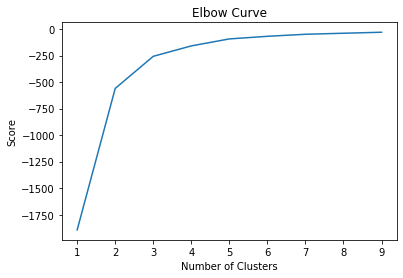

In [36]:
### k-means clustering
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
K_clusters = range(1,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = df_bc[['latitude']]
X_axis = df_bc[['longitude']]
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

In [37]:
from sklearn.cluster import KMeans
#Normalize the Data
from sklearn.preprocessing import StandardScaler

dfk=df_bc[['latitude','longitude']]
X = dfk.values[:,:]
X = np.nan_to_num(X)
#cluster_dataset = StandardScaler().fit_transform(X)
cluster_dataset=X
kmeans = KMeans(n_clusters = 5, init ='k-means++')
kmeans.fit(X) # Compute k-means clustering.
df_bc['cluster_label1'] = kmeans.fit_predict(cluster_dataset)
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(cluster_dataset) # Labels of each point
df_bc.head(10)

,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue,cluster_label,cluster_label1
0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022,3000.000000,2,4
1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307,3000.000000,0,3
2,München,1471508,Bayern,48.137108,11.575382,4148.926428,3000.000000,1,1
3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847,3000.000000,4,0
4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275,2839.296275,3,2
5,Stuttgart,634830,Baden-Württemberg,48.778449,9.180013,4225.232914,3000.000000,3,2
6,Düsseldorf,619294,Nordrhein-Westfalen,51.225402,6.776314,3323.229300,3000.000000,4,0
7,Leipzig,587857,Sachsen,51.340632,12.374733,3453.481674,3000.000000,2,4
8,Dortmund,587010,Nordrhein-Westfalen,51.514227,7.465279,5215.863960,3000.000000,4,0
9,Essen,583109,Nordrhein-Westfalen,51.458224,7.015817,4048.216099,3000.000000,4,0


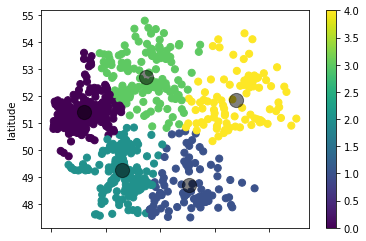

In [38]:
df_bc.plot.scatter(y = 'latitude', x = 'longitude', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 1], centers[:, 0], c='black', s=200, alpha=0.5)

In [39]:
df_bc.describe()

,2018,latitude,longitude,radius,radiusvenue,cluster_label,cluster_label1
count,7.000000e+02,700.000000,700.000000,700.000000,700.00000,700.000000,700.000000
mean,7.055497e+04,50.840461,9.216636,5928.999451,2817.22999,2.310000,1.728571
std,1.851357e+05,1.646020,1.994546,3857.271768,444.30703,1.502373,1.404279
min,2.003600e+04,47.493836,6.083862,0.000000,0.00000,0.000000,0.000000
25%,2.481825e+04,49.463711,7.636092,3071.638924,3000.00000,1.000000,0.000000
50%,3.359950e+04,51.060332,8.793391,4799.107952,3000.00000,3.000000,2.000000
75%,5.300250e+04,51.970875,10.436004,7717.250949,3000.00000,4.000000,3.000000
max,3.644826e+06,54.783302,14.991018,20486.014398,3000.00000,4.000000,4.000000


In [160]:
location = geolocator.geocode('Germany')
colormap=['green', 'yellow', 'red','blue','orange','magenta']


cities_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6) # generate map centred around the Conrad Hotel

# add a red circle marker to represent the Conrad Hotel
for name,latitude,longitude,radiusp,clusterlabel,population in zip(df_bc['Name'],df_bc['latitude'],df_bc['longitude'],df_bc['radiusvenue'],df_bc['cluster_label1'],df_bc['2018']):
    
    #folium.Circle([latitude,longitude], radius=radiusp, color='green',fill=False).add_to(cities_map)
    folium.CircleMarker(
        [latitude, longitude],
        radius=1+population/df_bc['2018'].max()*10,
        color=colormap[clusterlabel],
        popup=name,
        fill = True,
        fill_color = colormap[clusterlabel]).add_to(cities_map)

for coord in centers:
    folium.Circle(
        [coord[0], coord[1]],
        radius=10000,
        color='black',
        fill = True,
        fill_color = 'black').add_to(cities_map)

cities_map

In [200]:
df_bc.groupby('cluster_label').count()

,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue
cluster_label,,,,,,,
0,138,138,138,138,138,138,138
1,92,92,92,92,92,92,92
2,93,93,93,93,93,93,93
3,169,169,169,169,169,169,169
4,208,208,208,208,208,208,208


## Load all restaurants into the dataframe which are vegetarian restaurants.
The search is limited to the defined radius (max 3 km or less in case it overlaps with another citie's 3 km radius.)

We loop through our df_bc dataframe which contains all the big cities we are interested in and call foursquare for each city.

The loop appends the foursquare results to the dataframe "df_vegi_restaurants" which at the end contains all vegetarian restaurants.  We add the "bc_index" to group it later and count the amount of restaurants located in the defined radius for each city.

3644826

In [47]:
categories='4bf58dd8d48988d1d3941735' #vegetarian restaurants Ids-- see https://developer.foursquare.com/docs/build-with-foursquare/categories
df_vegi_restaurants=pd.DataFrame()
for index,latitude,longitude,radius in zip(df_bc.index,df_bc['latitude'],df_bc['longitude'],df_bc['radiusvenue']):
         
    print (index, latitude,longitude,radius)
    try:
        df_vegi_restaurants=df_vegi_restaurants.append(get_foursquare_categories(index,categories,latitude,longitude,radius,LIMIT), sort=False)
    except:
        print (index,"--FAILED--")

0 52.5170365 13.3888599 3000.0
1 53.5437641 10.0099133 3000.0
2 48.1371079 11.5753822 3000.0
3 50.938361 6.959974 3000.0
4 50.1106444 8.6820917 2839.296274850528
5 48.7784485 9.1800132 3000.0
6 51.2254018 6.7763137 3000.0
7 51.3406321 12.3747329 3000.0
8 51.5142273 7.4652789 3000.0
9 51.4582235 7.0158171 3000.0
10 53.0758196 8.8071646 3000.0
11 51.0493286 13.7381437 3000.0
12 52.3744779 9.7385532 3000.0
13 49.453872 11.077298 3000.0
14 51.434999 6.759562 3000.0
15 51.4818111 7.2196635 3000.0
16 51.264018 7.1780374 189.36221979565272
17 52.0191005 8.531007 3000.0
18 50.735851 7.10066 3000.0
19 51.9625101 7.6251879 3000.0
20 49.0068705 8.4034195 3000.0
21 49.489591 8.467236 1499.2367638893259
22 48.3668041 10.8986971 2754.5480823581665
23 50.0820384 8.2416556 3000.0
24 51.1946983 6.4353641 2771.9542513996657
25 51.5110321 7.0960124 3000.0
26 52.2646577 10.5236066 3000.0
27 54.3227085 10.135555 3000.0
28 50.776351 6.083862 2910.405848351544
29 50.8322608 12.9252977 3000.0
30 51.4825041 11

236 47.8803788 10.622246 3000.0
237 52.5678244 13.0855621 3000.0
238 47.9867696 10.181319 3000.0
239 48.47696 8.9336788 3000.0
240 51.226675 6.6193924 2918.439714150821
241 51.080992 6.3160684 3000.0
242 53.7278939 9.6979598 2060.245244589835
243 48.9502631 9.1383314 3000.0
244 51.5918019 7.6616804 1558.98409001701
245 53.8909832 11.4647932 3000.0
246 51.8443183 6.8582247 3000.0
247 49.6752749 12.1631636 3000.0
248 52.57806125 10.661344801415442 3000.0
249 51.3066628 6.2364082 3000.0
250 50.9833 10.3166999 3000.0
251 50.011974 8.7123912 2060.5760344754267
252 53.4695604 7.4823808 3000.0
253 49.4454211 11.858728 3000.0
254 51.0654268 6.0984461 3000.0
255 49.3028611 10.5722288 3000.0
256 49.3181673 7.3340336 3000.0
257 51.5051574 10.7925317 3000.0
258 52.4257979 9.4294425 3000.0
259 53.3965903 10.0176952 3000.0
260 50.7928332 7.2070774 1155.6197412302406
261 52.3077423 9.8132829 3000.0
262 50.258112 10.964463 3000.0
263 50.6761759 7.1935237 2110.9984878118194
264 48.6265854 9.3365463 300

467 52.5814009 13.8833952 3000.0
468 49.5118126 11.2813381 3000.0
469 49.191735 9.2249443 2758.9547611864014
470 48.8749515 9.2649047 2945.2583023802686
471 51.32658 6.9710401 2660.201604185578
472 51.4729797 11.2981851 3000.0
473 52.6375777 13.2057511 3000.0
474 48.2828519 9.7262175 3000.0
475 50.4340422 8.6711184 3000.0
476 53.4973636 8.4820227 3000.0
477 52.3715809 12.9329125 3000.0
478 52.6732755 13.2807255 3000.0
479 52.3016096 13.2610163 3000.0
480 48.9487272 8.8492931 3000.0
481 49.6416143 8.6333327 2224.172940888382
482 51.7005549 7.468614 3000.0
483 49.9060908 8.584137 2491.209245502094
484 48.5296743 11.5084954 3000.0
485 50.1008448 11.4479149 3000.0
486 51.7500048 11.9666985 3000.0
487 49.4669906 7.1696192 3000.0
488 52.4016457 13.2644532 1413.300454275591
489 50.6448582 7.2272534 2110.9984878118194
490 52.2277037 11.0104702 3000.0
491 49.9667 7.9 3000.0
492 48.6300161 8.0735581 3000.0
493 49.445762 10.9560462 2132.8884999914417
494 49.1952934 11.056652343301323 3000.0
495 5

In [53]:
df_vegi_restaurants=df_vegi_restaurants.reset_index(drop=True) # reset the index, drop the old one
df_vegi_restaurants.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 689 entries, 0 to 688
Data columns (total 20 columns):
id                           689 non-null object
name                         689 non-null object
categories                   689 non-null object
referralId                   689 non-null object
hasPerk                      689 non-null object
location.address             524 non-null object
location.lat                 689 non-null float64
location.lng                 689 non-null float64
location.labeledLatLngs      689 non-null object
location.distance            689 non-null float64
location.postalCode          469 non-null object
location.cc                  689 non-null object
location.city                606 non-null object
location.state               607 non-null object
location.country             689 non-null object
location.formattedAddress    689 non-null object
location.crossStreet         77 non-null object
location.neighborhood        45 non-null object
venuePage.id

In [158]:
df_vegi_restaurants.head()

,id,name,categories,referralId,hasPerk,location.address,location.lat,location.lng,location.labeledLatLngs,location.distance,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,location.crossStreet,location.neighborhood,venuePage.id,city_index
0,4adf61aef964a520177a21e3,Cookies Cream,"[{'id': '4bf58dd8d48988d1d3941735', 'name': 'V...",v-1586636635,False,Behrenstr. 55,52.516569,13.388008,"[{'label': 'display', 'lat': 52.51656861215425...",77.0,10117,DE,Berlin,Berlin,Deutschland,"[Behrenstr. 55, 10117 Berlin, Deutschland]",NaN,NaN,NaN,0
1,5810e4b7d67cadfa1e4528bb,W - Der Imbiss,"[{'id': '4bf58dd8d48988d1d3941735', 'name': 'V...",v-1586636635,False,Nollendorfstr. 10,52.498095,13.353152,"[{'label': 'display', 'lat': 52.49809494127663...",3209.0,10777,DE,Berlin,Berlin,Deutschland,"[Nollendorfstr. 10 (Nollendorfplatz), 10777 Be...",Nollendorfplatz,NaN,NaN,0
2,5dda6abc154c6b00085815f2,Försters,"[{'id': '4bf58dd8d48988d1d3941735', 'name': 'V...",v-1586636635,False,Dunckerstr. 2A,52.540787,13.419494,"[{'label': 'display', 'lat': 52.540787, 'lng':...",3360.0,10437,DE,Berlin,Berlin,Deutschland,"[Dunckerstr. 2A, 10437 Berlin, Deutschland]",NaN,NaN,NaN,0
3,5af5e4aa829b0c002ba3f8a0,Anh Dao,"[{'id': '4bf58dd8d48988d14a941735', 'name': 'V...",v-1586636635,False,Danziger Straße 42,52.540176,13.419122,"[{'label': 'display', 'lat': 52.540176, 'lng':...",3291.0,10435,DE,Berlin,Berlin,Deutschland,"[Danziger Straße 42, 10435 Berlin, Deutschland]",NaN,NaN,NaN,0
4,5a8c089ce7a237608e565e29,Glückscafé,"[{'id': '4bf58dd8d48988d1e0931735', 'name': 'C...",v-1586636635,False,Chausseestr. 48a,52.535202,13.377567,"[{'label': 'display', 'lat': 52.535202, 'lng':...",2161.0,10115,DE,Berlin,Berlin,Deutschland,"[Chausseestr. 48a, 10115 Berlin, Deutschland]",NaN,Mitte,NaN,0


In [4]:
df_vegi_restaurants.groupby('city_index').count()

,id,name,categories,referralId,hasPerk,location.address,location.lat,location.lng,location.labeledLatLngs,location.distance,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,location.crossStreet,location.neighborhood,venuePage.id
city_index,,,,,,,,,,,,,,,,,,,
0,49,49,49,49,49,49,49,49,49,49,46,49,48,48,49,49,10,12,6
1,26,26,26,26,26,24,26,26,26,26,22,26,25,25,26,26,4,1,1
2,47,47,47,47,47,34,47,47,47,47,28,47,43,43,47,47,15,3,5
3,42,42,42,42,42,39,42,42,42,42,36,42,42,42,42,42,1,6,1
4,25,25,25,25,25,14,25,25,25,25,11,25,24,24,25,25,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
657,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,0,0
659,1,1,1,1,1,0,1,1,1,1,0,1,0,0,1,1,0,0,0
673,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0


In [21]:
categories='52f2ab2ebcbc57f1066b8b45' #organic grocery Ids-- see https://developer.foursquare.com/docs/build-with-foursquare/categories
df_organic_groceries=pd.DataFrame()
for index,latitude,longitude,radius in zip(df_bc.index,df_bc['latitude'],df_bc['longitude'],df_bc['radiusvenue']):
         
    print (index, latitude,longitude,radius)
    try:
        df_organic_groceries=df_organic_groceries.append(get_foursquare_categories(index,categories,latitude,longitude,radius,LIMIT), sort=False)
    except:
        print (index,"--FAILED--")

0 52.5170365 13.3888599 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.5170365,13.3888599&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
1 53.5437641 10.0099133 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.5437641,10.0099133&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
2 48.1371079 11.5753822 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.1371079,11.5753822&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
3 50.938361 6.959974 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT

28 50.776351 6.083862 2910.405848351544
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.776351,6.083862&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2910.405848351544&limit=50
29 50.8322608 12.9252977 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.8322608,12.9252977&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
30 51.4825041 11.9705452 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.4825041,11.9705452&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
31 52.1315889 11.6399609 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PU

56 48.7630165 11.4250395 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.7630165,11.4250395&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
57 50.1055002 8.7610698 2839.296274850528
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.1055002,8.7610698&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2839.296274850528&limit=50
58 49.79245 9.932966 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.79245,9.932966&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
59 49.477263 10.989616 2132.8884999914417
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDT

84 53.6288297 11.4148038 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.6288297,11.4148038&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
85 50.8772301 12.0796208 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.8772301,12.0796208&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
86 48.7427584 9.3071685 2132.5455855648743
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.7427584,9.3071685&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2132.5455855648743&limit=50
87 48.8953937 9.1895147 1905.6847411473786
https://api.foursquare.com/v2/venues/search?client_id=XB

112 53.248706 10.407855 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.248706,10.407855&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
113 50.8153071 7.1593271 2096.4752544535313
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.8153071,7.1593271&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2096.4752544535313&limit=50
114 51.6604071 6.9647431 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.6604071,6.9647431&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
115 49.9427202 11.5763079 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQU

140 47.8539273 12.127262 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=47.8539273,12.127262&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
141 51.5942009 7.1368071 2394.2581978114254
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.5942009,7.1368071&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2394.2581978114254&limit=50
142 50.9540457 6.6410004 2672.0389609567146
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.9540457,6.6410004&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2672.0389609567146&limit=50
143 48.7999036 9.7977584 3000.0
https://api.foursquare.com/v2/venues/search?

168 50.2373164 8.568604363062613 2087.9745985044133
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.2373164,8.568604363062613&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2087.9745985044133&limit=50
169 52.443118 9.738994 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.443118,9.738994&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
170 52.0857452 8.7534422 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.0857452,8.7534422&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
171 50.9979888 6.8025409 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XB

196 47.6120896 7.6607218 1971.097219980651
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=47.6120896,7.6607218&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1971.097219980651&limit=50
197 48.8012314 9.0151938 2327.6183777056995
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.8012314,9.0151938&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2327.6183777056995&limit=50
198 51.6149389 7.6362876 1558.98409001701
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.6149389,7.6362876&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1558.98409001701&limit=50
199 52.2014399 8.7981244 2873.5340854244014
https://api.fo

224 50.9462725 10.6945265 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.9462725,10.6945265&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
225 48.8181556 9.278085 2355.515307022706
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.8181556,9.278085&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2355.515307022706&limit=50
226 52.2003644 8.5827558 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.2003644,8.5827558&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
227 48.2342372 9.0104093 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR

253 49.4454211 11.858728 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.4454211,11.858728&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
254 51.0654268 6.0984461 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.0654268,6.0984461&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
255 49.3028611 10.5722288 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.3028611,10.5722288&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
256 49.3181673 7.3340336 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR

281 50.094119250000006 8.422628824132978 2576.360654577152
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.094119250000006,8.422628824132978&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2576.360654577152&limit=50
282 52.1990346 8.7141587 2873.5340854244014
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.1990346,8.7141587&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2873.5340854244014&limit=50
283 48.8055169 9.5272665 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.8055169,9.5272665&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
284 51.016265 13.6530329 3000.0
https://api.fo

309 50.6867695 10.9142385 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.6867695,10.9142385&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
310 51.7555148 8.041135 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.7555148,8.041135&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
311 48.3064441 11.9076579 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.3064441,11.9076579&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
312 51.9458943 7.1691108 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR

337 49.2535955 7.370627437376278 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.2535955,7.370627437376278&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
338 49.5401174 8.5788029 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.5401174,8.5788029&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
339 52.1294289 7.3903454 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.1294289,7.3903454&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
340 51.3854116 7.7661798 2380.8936858497514
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVS

365 50.3681107 8.7473608 1841.532146745483
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.3681107,8.7473608&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1841.532146745483&limit=50
366 50.9852411 12.4340988 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.9852411,12.4340988&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
367 51.7649178 8.5594953 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.7649178,8.5594953&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
368 52.3580209 14.064985 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQ

393 47.6048182 7.6094052 1971.097219980651
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=47.6048182,7.6094052&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1971.097219980651&limit=50
394 51.2967192 7.3693335 1672.6541298707584
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.2967192,7.3693335&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1672.6541298707584&limit=50
395 51.3038241 13.308828 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.3038241,13.308828&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
396 50.1428619 8.1597609 3000.0
https://api.foursquare.com/v2/venues/search?cl

421 49.3261854 12.1092708 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.3261854,12.1092708&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
422 51.7747369 9.3816877 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.7747369,9.3816877&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
423 50.8963758 7.1825445 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.8963758,7.1825445&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
424 53.185155 8.0034877 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0

449 50.5909999 6.6525479 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.5909999,6.6525479&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
450 50.0723029 8.4861389 2576.360654577152
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.0723029,8.4861389&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2576.360654577152&limit=50
451 51.3879463 7.3951553 1480.9130986704436
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.3879463,7.3951553&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1480.9130986704436&limit=50
452 49.8615899 8.5762043 2491.209245502094
https://api.foursquare.com/v2/venue

477 52.3715809 12.9329125 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.3715809,12.9329125&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
478 52.6732755 13.2807255 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.6732755,13.2807255&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
479 52.3016096 13.2610163 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.3016096,13.2610163&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
480 48.9487272 8.8492931 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU

505 54.51851 9.5653284 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=54.51851,9.5653284&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
506 47.8646925 11.479351 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=47.8646925,11.479351&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
507 48.165531 8.6251283 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.165531,8.6251283&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
508 50.2556672 8.6511395 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2U

533 48.9615975 10.131975 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.9615975,10.131975&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
534 49.0895249 8.4856806 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=49.0895249,8.4856806&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
535 52.4337239 9.8492392 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.4337239,9.8492392&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
536 49.2005034 9.5024397 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0Y

561 48.2058812 12.4044209 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.2058812,12.4044209&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
562 53.3196227 7.4225093 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.3196227,7.4225093&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
563 48.1058205 11.7710207 1566.3239673855664
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.1058205,11.7710207&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=1566.3239673855664&limit=50
564 49.3527796 9.1455235 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVS

589 48.4248151 10.8778564 2370.208351113087
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.4248151,10.8778564&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2370.208351113087&limit=50
590 53.0207 7.85911 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.0207,7.85911&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
591 50.1983954 10.0750993 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.1983954,10.0750993&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
592 50.8199031 12.5397873 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNE

617 54.1948456 9.0929015 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=54.1948456,9.0929015&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
618 50.9371308 6.5698302 2672.0389609567146
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=50.9371308,6.5698302&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2672.0389609567146&limit=50
619 51.9640308 12.0857291 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.9640308,12.0857291&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
620 52.0621677 8.3593157 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMD

645 53.5217959 12.6805557 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.5217959,12.6805557&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
646 51.2818569 7.0328063 2510.8092129951815
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=51.2818569,7.0328063&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=2510.8092129951815&limit=50
647 53.15 7.46667 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=53.15,7.46667&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
648 51.1155182 7.3879068 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2J

674 48.8516578 10.4885873 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.8516578,10.4885873&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
675 52.5 9.86667 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=52.5,9.86667&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
676 48.968549 8.3097117 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&client_secret=ASMBYTIKO1BBYZTV5OW1CQFUMTIMPBSGBDRM2ZWDDTSMJXPJ&ll=48.968549,8.3097117&v=20180604&categoryId=52f2ab2ebcbc57f1066b8b45&radius=3000.0&limit=50
677 50.2290263 8.8762327 3000.0
https://api.foursquare.com/v2/venues/search?client_id=XBJ1BHFPVSMDTQUR5PUNEAES2JPKNYQU3FRR0YLHJT2UG3R5&clien

In [23]:
df_organic_groceries=df_organic_groceries.reset_index(drop=True) # reset the index, drop the old one


df_organic_groceries.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 625 entries, 0 to 624
Data columns (total 20 columns):
id                           625 non-null object
name                         625 non-null object
categories                   625 non-null object
referralId                   625 non-null object
hasPerk                      625 non-null object
location.address             461 non-null object
location.lat                 625 non-null float64
location.lng                 625 non-null float64
location.labeledLatLngs      625 non-null object
location.distance            625 non-null float64
location.postalCode          441 non-null object
location.cc                  625 non-null object
location.city                524 non-null object
location.state               527 non-null object
location.country             625 non-null object
location.formattedAddress    625 non-null object
venuePage.id                 32 non-null object
location.neighborhood        20 non-null object
location.cro

In [24]:
df_organic_groceries.iloc[0,2]

[{'id': '52f2ab2ebcbc57f1066b8b45',
  'name': 'Organic Grocery',
  'pluralName': 'Organic Groceries',
  'shortName': 'Organic Grocery',
  'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_',
   'suffix': '.png'},
  'primary': True}]

In [64]:
from folium.plugins import MarkerCluster

location = geolocator.geocode('Germany')
organic_grocery_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6) # generate map 
mco=MarkerCluster()
for name,latitude,longitude, address in zip(df_organic_groceries['name'], df_organic_groceries['location.lat'],df_organic_groceries['location.lng'],df_organic_groceries['location.formattedAddress']):
    address=',\n'.join(address)
    name=name+'\n'+address
    
    mco.add_child(folium.Marker(
        [latitude, longitude],
        popup=name,
       icon=folium.Icon(color="green",icon="shopping-bag", prefix='fa')))
organic_grocery_map.add_child(mco)
organic_grocery_map

In [281]:
import folium
import geopandas as gpd
from folium.map import Layer, FeatureGroup,LayerControl,Marker
from folium.plugins import MarkerCluster,FeatureGroupSubGroup,Fullscreen
#get the german borders from the shapefile (stored locally)
shape=gpd.read_file('./german_border/VG1000_STA.shp')

location = geolocator.geocode('Germany')


cities_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6,figsize=(20,20)) # generate map centred around the Conrad Hotel
# Add tiles
folium.TileLayer(tiles="CartoDB positron").add_to(cities_map)

#city population feature group which can be clicked off and on
# 1. cities  20000 up to less than 100000
# 2. cities  100000 up to less than 500000
# 3. cities  500000 up to less than 1 mio
# 4. cities  1mio and bigger (there are quite not many in Germany ;O)
cm=['green','blue','orange','red','purple']
lgd_txt = '<span style="color: {col};">{txt}</span>'    
# create marker clusters (at certain zoom level this shows one point with numbers instead individual points)

markercluster=MarkerCluster(control = False).add_to(cities_map)
#markercluster.add_to(cities_map)
markercluster1=MarkerCluster(control = False).add_to(cities_map)

#FeatureGroupSubGroup(marker_cluster, name = event, control = True, show = True)

# create feature groups
fg=[0 for i in range(0,6)]
#CreateFeatureGroup as this is not under markercluster control (does not work as expected)
fg[0] = FeatureGroup(name= lgd_txt.format( txt= 'Venue search area', col= cm[0]),control=True,show=False)
#FeatureGroupSubGroup works well together with Markercluster
fg[1] = FeatureGroupSubGroup(markercluster,name='Organic Grocery Stores',overlay=True) 
fg[2] = FeatureGroupSubGroup(markercluster1,name='Vegetarian Restaurants') 
fg[5] = FeatureGroupSubGroup(markercluster,name= lgd_txt.format(txt='German Border', col='blue'),control=True,show=False)

fg[5].add_child(folium.GeoJson(shape))  # Add German Borders to the map (the origin is a "shapefile")

for name,latitude,longitude,address in zip(df_organic_groceries['name'], df_organic_groceries['location.lat'],df_organic_groceries['location.lng'],df_organic_groceries['location.formattedAddress']):
    address=',\n'.join(address)
    fname=name+'\n'+address
    folium.Marker(
        [latitude, longitude],
        name='Organic Grocery Store',
        popup=fname,
        icon=folium.Icon(color="green",icon="shopping-bag", prefix='fa')).add_to(fg[1])


for name,latitude,longitude,radiusp,population,popcat in zip(df_bc['Name'],df_bc['latitude'],df_bc['longitude'],df_bc['radiusvenue'],df_bc['2018'],df_bc['pop_cat']):
    
    ra=folium.Circle([latitude,longitude], radius=radiusp, color='green',fill=False)
    fg[0].add_child(ra)
    
for name,latitude,longitude, address in zip(df_vegi_restaurants['name'], df_vegi_restaurants['location.lat'],df_vegi_restaurants['location.lng'],df_vegi_restaurants['location.formattedAddress']):
    address=',\n'.join(address)
    name=name+'\n'+address
    fg[2].add_child(folium.Marker(
        [latitude, longitude],
        popup=name,
       icon=folium.Icon(color="orange",icon="utensil", prefix="fa")))
    
    
fg[0].add_to(cities_map)
fg[1].add_to(cities_map)
fg[2].add_to(cities_map)
fg[5].add_to(cities_map)

    
folium.map.LayerControl('topleft', collapsed= False).add_to(cities_map)    
Fullscreen().add_to(cities_map) # Button to activate Fullscreen mode
cities_map

In [62]:
from folium.plugins import MarkerCluster

location = geolocator.geocode('Germany')
vegi_restaurants_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6) # generate map 
mc=MarkerCluster()
for name,latitude,longitude, address in zip(df_vegi_restaurants['name'], df_vegi_restaurants['location.lat'],df_vegi_restaurants['location.lng'],df_vegi_restaurants['location.formattedAddress']):
    address=',\n'.join(address)
    name=name+'\n'+address
    mc.add_child(folium.Marker(
        [latitude, longitude],
        popup=name,
       icon=folium.Icon(color="blue",icon="utensil", prefix="fa")))

vegi_restaurants_map.add_child(mc)
vegi_restaurants_map
#legend = folium.Html("<div>Legend</div>")
#legend.add_to(cities_map)
#legend_div = folium.Div("20%", "20%", "75%", "5%")
    
#legend_div.add_to(cities_map)
#legend_div.add_child(legend)
    
    
# add legend:legend_html
#legend_html = '''
#     <div style=”position: fixed; 
#     bottom: 50px; left: 50px; width: 100px; height: 90px; 
#     border:2px solid grey; z-index:9999; font-size:14px;
#     “>&nbsp; Cool Legend <br>
#     &nbsp; East &nbsp; <i class=”fa fa-map-marker fa-2x”
#                  style=”color:green”></i><br>
#     &nbsp; West &nbsp; <i class=”fa fa-map-marker fa-2x”
#                  style=”color:red”></i>
#      </div>
#     '''
#cities_map.get_root().html.add_child(folium.Element(legend_html))
#cities_map

## Now append the foursquare data (sum of locations for each city) as new feature (=column) to  pandas Dataframe
 - Regression Anzahl an Groceries vs Restaurants
 - Regression Anzahl an Einwohnern vs Restaurants und Groceries
 - Saturation Index => Anzahl an Supermärkten pro Stadt pro 100000 Einwohnern / Max Wert davon
 - 

In [66]:
# add amount of restaurants and groceries to the DF df_bc
# left join df_bc => df_vegi_restaurants
# Left join df_bc => df_organic_groceries
df_vegi_restaurants.head()


,id,name,categories,referralId,hasPerk,location.address,location.lat,location.lng,location.labeledLatLngs,location.distance,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,location.crossStreet,location.neighborhood,venuePage.id,city_index
0,4adf61aef964a520177a21e3,Cookies Cream,"[{'id': '4bf58dd8d48988d1d3941735', 'name': 'V...",v-1586636635,False,Behrenstr. 55,52.516569,13.388008,"[{'label': 'display', 'lat': 52.51656861215425...",77.0,10117,DE,Berlin,Berlin,Deutschland,"[Behrenstr. 55, 10117 Berlin, Deutschland]",NaN,NaN,NaN,0
1,5810e4b7d67cadfa1e4528bb,W - Der Imbiss,"[{'id': '4bf58dd8d48988d1d3941735', 'name': 'V...",v-1586636635,False,Nollendorfstr. 10,52.498095,13.353152,"[{'label': 'display', 'lat': 52.49809494127663...",3209.0,10777,DE,Berlin,Berlin,Deutschland,"[Nollendorfstr. 10 (Nollendorfplatz), 10777 Be...",Nollendorfplatz,NaN,NaN,0
2,5dda6abc154c6b00085815f2,Försters,"[{'id': '4bf58dd8d48988d1d3941735', 'name': 'V...",v-1586636635,False,Dunckerstr. 2A,52.540787,13.419494,"[{'label': 'display', 'lat': 52.540787, 'lng':...",3360.0,10437,DE,Berlin,Berlin,Deutschland,"[Dunckerstr. 2A, 10437 Berlin, Deutschland]",NaN,NaN,NaN,0
3,5af5e4aa829b0c002ba3f8a0,Anh Dao,"[{'id': '4bf58dd8d48988d14a941735', 'name': 'V...",v-1586636635,False,Danziger Straße 42,52.540176,13.419122,"[{'label': 'display', 'lat': 52.540176, 'lng':...",3291.0,10435,DE,Berlin,Berlin,Deutschland,"[Danziger Straße 42, 10435 Berlin, Deutschland]",NaN,NaN,NaN,0
4,5a8c089ce7a237608e565e29,Glückscafé,"[{'id': '4bf58dd8d48988d1e0931735', 'name': 'C...",v-1586636635,False,Chausseestr. 48a,52.535202,13.377567,"[{'label': 'display', 'lat': 52.535202, 'lng':...",2161.0,10115,DE,Berlin,Berlin,Deutschland,"[Chausseestr. 48a, 10115 Berlin, Deutschland]",NaN,Mitte,NaN,0


In [88]:
df_temp=df_vegi_restaurants.groupby('city_index').count().reset_index()
df_temp=df_temp[['city_index','id']]

df_temp.rename(columns={'id':'count_vegi_rest'}, inplace=True)
df_temp.describe()


,city_index,count_vegi_rest
count,167.000000,167.000000
mean,189.281437,4.125749
std,189.743450,7.037062
min,0.000000,1.000000
25%,43.500000,1.000000
50%,114.000000,2.000000
75%,276.000000,4.000000
max,695.000000,49.000000


In [106]:
# Left join df_by => df_vegi_restaurants
# first do a copy for df_bc
df_bc_1=df_bc.copy()
df_bc_1.index.name='city_index'
df_bc_1=df_bc_1.merge(df_temp, on='city_index', how='left')
# There are cities where foursquqare did not deliver any grocery store so the amount is empty here , so we will replace it by 0 values
print("Rows with Null values: ",df_bc_1[df_bc_1.isnull().any(axis=1)].shape[0])

#replace No values by zeros
df_bc_1['count_vegi_rest']=df_bc_1['count_vegi_rest'].fillna(0)
print("Rows with Null values after replaced by zeros: ",df_bc_1[df_bc_1.isnull().any(axis=1)].shape[0])

Rows with Null values:  533
Rows with Null values after replaced by zeros:  0


In [107]:
df_bc_1

,city_index,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue,count_vegi_rest
0,0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022,3000.000000,49.0
1,1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307,3000.000000,26.0
2,2,München,1471508,Bayern,48.137108,11.575382,4148.926428,3000.000000,47.0
3,3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847,3000.000000,42.0
4,4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275,2839.296275,25.0
...,...,...,...,...,...,...,...,...,...
695,695,Donauwörth,20080,Bayern,48.718036,10.780730,13054.681709,3000.000000,1.0
696,696,Oberkirch,20066,Baden-Württemberg,48.530712,8.078400,5524.264804,3000.000000,0.0
697,697,Torgau,20065,Sachsen,51.558127,13.004654,17663.307371,3000.000000,0.0
698,698,Dillingen/Saar,20048,Saarland,49.355272,6.724320,2348.853053,2348.853053,0.0


In [118]:


# Left join df_bc => df_organic_groceries
# fc
df_temp=df_organic_groceries.groupby('city_index').count().reset_index()
df_temp=df_temp[['city_index','id']]

df_temp.rename(columns={'id':'count_org_grocs'}, inplace=True)


df_bc_1=df_bc_1.merge(df_temp, on='city_index', how='left')
# There are cities where foursquqare did not deliver any grocery store so the amount is empty here , so we will replace it by 0 values
print("Rows with Null values: ",df_bc_1[df_bc_1.isnull().any(axis=1)].shape[0])

#replace No values by zeros
df_bc_1['count_org_grocs']=df_bc_1['count_org_grocs'].fillna(0)
print("Rows with Null values after replaced by zeros: ",df_bc_1[df_bc_1.isnull().any(axis=1)].shape[0])

Rows with Null values:  456
Rows with Null values after replaced by zeros:  0


In [119]:
df_bc_1

,city_index,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue,count_vegi_rest,count_org_grocs
0,0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022,3000.000000,49.0,39.0
1,1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307,3000.000000,26.0,12.0
2,2,München,1471508,Bayern,48.137108,11.575382,4148.926428,3000.000000,47.0,36.0
3,3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847,3000.000000,42.0,18.0
4,4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275,2839.296275,25.0,15.0
...,...,...,...,...,...,...,...,...,...,...
695,695,Donauwörth,20080,Bayern,48.718036,10.780730,13054.681709,3000.000000,1.0,0.0
696,696,Oberkirch,20066,Baden-Württemberg,48.530712,8.078400,5524.264804,3000.000000,0.0,0.0
697,697,Torgau,20065,Sachsen,51.558127,13.004654,17663.307371,3000.000000,0.0,0.0
698,698,Dillingen/Saar,20048,Saarland,49.355272,6.724320,2348.853053,2348.853053,0.0,1.0


In [349]:
df_bc_1.head()

,city_index,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue,count_vegi_rest,count_org_grocs,cluster_label
0,0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022,3000.000000,49.0,39.0,4
1,1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307,3000.000000,26.0,12.0,1
2,2,München,1471508,Bayern,48.137108,11.575382,4148.926428,3000.000000,47.0,36.0,1
3,3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847,3000.000000,42.0,18.0,1
4,4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275,2839.296275,25.0,15.0,3


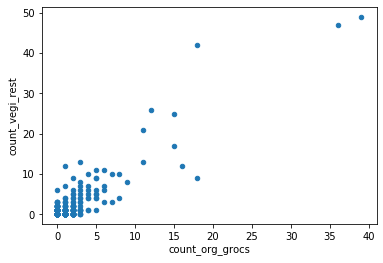

In [123]:
df_bc_1.plot(kind='scatter',x='count_org_grocs',y='count_vegi_rest')

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
import pylab as pl
import numpy as np
%matplotlib inline

In [129]:
df_bc_1.corr()

,city_index,2018,latitude,longitude,radius,radiusvenue,count_vegi_rest,count_org_grocs
city_index,1.000000,-0.364324,-0.049246,0.123503,0.049078,0.025880,-0.350882,-0.349808
2018,-0.364324,1.000000,0.048433,0.041748,-0.028874,0.030865,0.879614,0.854932
latitude,-0.049246,0.048433,1.000000,-0.004071,0.106045,0.169987,-0.028095,-0.045806
longitude,0.123503,0.041748,-0.004071,1.000000,0.459109,0.108077,0.064406,0.079492
radius,0.049078,-0.028874,0.106045,0.459109,1.000000,0.447517,-0.005744,-0.033433
radiusvenue,0.025880,0.030865,0.169987,0.108077,0.447517,1.000000,0.069383,0.052952
count_vegi_rest,-0.350882,0.879614,-0.028095,0.064406,-0.005744,0.069383,1.000000,0.896054
count_org_grocs,-0.349808,0.854932,-0.045806,0.079492,-0.033433,0.052952,0.896054,1.000000


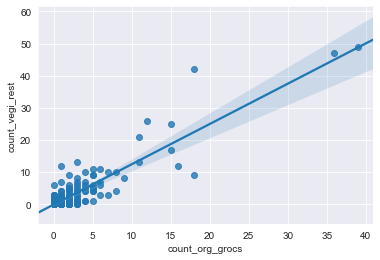

In [154]:
sns.regplot(x='count_org_grocs',y='count_vegi_rest',data=df_bc_1)
#sns.set_style('darkgrid')

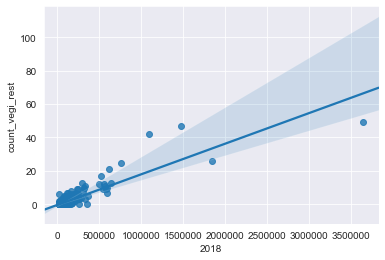

In [155]:
sns.regplot(x='2018',y='count_vegi_rest',data=df_bc_1)

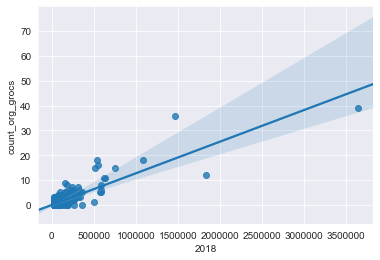

In [156]:
sns.regplot(x='2018',y='count_org_grocs',data=df_bc_1)

In [43]:
# Density:  Build a new Dataframe: - same rows as df_bc but some different features which will be the input for K-Means clustering
#  Columns are: Citizens, radius, Amount of grocery stores divided by radius^2, Amount of vegetarien restaurants divided by radius^2

df_calc=df_bc_1.copy()

df_calc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 700 entries, 0 to 699
Data columns (total 11 columns):
city_index         700 non-null int64
Name               700 non-null object
2018               700 non-null int64
Bundesland         700 non-null object
latitude           700 non-null float64
longitude          700 non-null float64
radius             700 non-null float64
radiusvenue        700 non-null float64
count_vegi_rest    700 non-null float64
count_org_grocs    700 non-null float64
cluster_label      700 non-null int32
dtypes: float64(6), int32(1), int64(2), object(2)
memory usage: 62.9+ KB


## Calculating the Risk score
We now need indicators where we should place our vegetarian restaurant.
The idea is to build the ratio of numbers existing vegetarian restaurant divided by existing organic grocery stores.

In [89]:
df_calc['groc_store_density']=df_calc['count_org_grocs']*100000/df_calc['radiusvenue']**2
df_calc['vegi_rest_density']=df_calc['count_vegi_rest']*100000/df_calc['radiusvenue']**2
df_calc['vegi_per_groc']=df_calc['count_vegi_rest']/df_calc['count_org_grocs']

#check for count_org_grocs=0 , those we have to classify separate (no ratio score can be calculated) 
#df_calc[df_calc['count_org_grocs']==0].count()


#df_calc[df_calc.isnull().any(axis=1)]
#df_calc.shape

df_calc1=df_calc.copy()
df_calc1=df_calc1.replace([np.inf, -np.inf], np.nan)
df_calc1= df_calc1.dropna()


df_calc1.shape
#df_calc1.head()

(244, 14)

In [90]:
df_calc1.corr()

,city_index,2018,latitude,longitude,radius,radiusvenue,count_vegi_rest,count_org_grocs,cluster_label,groc_store_density,vegi_rest_density,vegi_per_groc
city_index,1.000000,-0.376260,-0.096386,0.167222,0.010893,-0.091038,-0.406269,-0.357547,-0.503303,-0.311843,-0.312741,-0.419739
2018,-0.376260,1.000000,0.119082,0.081960,-0.023339,0.088613,0.882299,0.866711,0.349513,0.647551,0.556454,0.279486
latitude,-0.096386,0.119082,1.000000,-0.044664,0.002643,0.185796,0.032545,0.019521,0.016845,-0.090469,-0.049454,0.038839
longitude,0.167222,0.081960,-0.044664,1.000000,0.387463,-0.006035,0.072584,0.121725,0.005483,0.115069,0.057602,0.002899
radius,0.010893,-0.023339,0.002643,0.387463,1.000000,0.440288,-0.016943,-0.041323,-0.125713,-0.181414,-0.094129,0.105305
radiusvenue,-0.091038,0.088613,0.185796,-0.006035,0.440288,1.000000,0.112338,0.103390,-0.061973,-0.388400,-0.226818,0.090045
count_vegi_rest,-0.406269,0.882299,0.032545,0.072584,-0.016943,0.112338,1.000000,0.902735,0.411219,0.672659,0.640270,0.420965
count_org_grocs,-0.357547,0.866711,0.019521,0.121725,-0.041323,0.103390,0.902735,1.000000,0.385648,0.739246,0.548449,0.154345
cluster_label,-0.503303,0.349513,0.016845,0.005483,-0.125713,-0.061973,0.411219,0.385648,1.000000,0.381221,0.300275,0.402944
groc_store_density,-0.311843,0.647551,-0.090469,0.115069,-0.181414,-0.388400,0.672659,0.739246,0.381221,1.000000,0.765459,0.146618



These are  244 cities where we can find at least one organic grocery store.  The other 456 cities dont have any organic grocery store. Thus, we cannot calculate the ratio per city: 
     (count of vegi-restaurants / count of organic grocery stores).
The 456 cities with 0 organic grocery stores we will have to classify as "high risk" due to non existing ratio. 

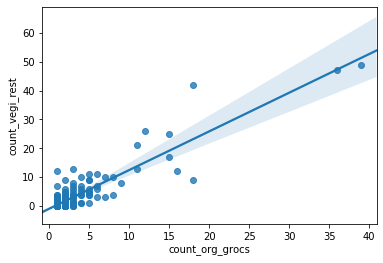

In [344]:
sns.regplot(x='count_org_grocs',y='count_vegi_rest',data=df_calc1)

In [94]:
from sklearn import linear_model
regr = linear_model.LinearRegression()

from sklearn.metrics import r2_score

test_x = np.asanyarray(df_calc1[['count_org_grocs']])
test_y = np.asanyarray(df_calc1[['count_vegi_rest']])
regr.fit (test_x, test_y)
test_y_hat = regr.predict(test_x)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y_hat , test_y) )



Mean absolute error: 1.45
Residual sum of squares (MSE): 7.12
R2-score: 0.77


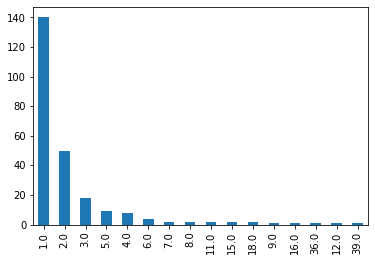

In [97]:
df_calc1['count_org_grocs'].value_counts().plot(kind='bar')

In [98]:
df_calc1[(df_calc1['count_vegi_rest']!=0) & (df_calc['count_org_grocs']==0)].count()

C:\Users\heinz\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


city_index            0
Name                  0
2018                  0
Bundesland            0
latitude              0
longitude             0
radius                0
radiusvenue           0
count_vegi_rest       0
count_org_grocs       0
cluster_label         0
groc_store_density    0
vegi_rest_density     0
vegi_per_groc         0
dtype: int64

In [99]:
df_calc2=df_calc[['2018','vegi_per_groc']].copy()
df_calc2.head()

,2018,vegi_per_groc
0,3644826,1.256410
1,1841179,2.166667
2,1471508,1.305556
3,1085664,2.333333
4,753056,1.666667


In [100]:
df_calc2=df_calc2.replace([np.inf, -np.inf], np.nan)
df_calc2= df_calc2.dropna()
df_calc2[df_calc2.isnull().any(axis=1)]
df_calc2.shape

(244, 2)

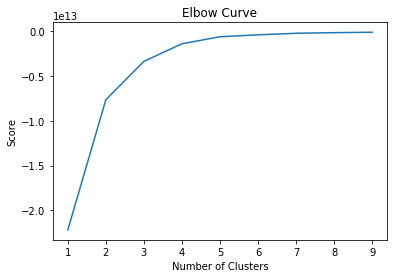

In [101]:

# For KMeans Clustering get the best k value 
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
K_clusters = range(1,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]

score = [kmeans[i].fit(df_calc2).score(df_calc2) for i in range(len(kmeans))]
# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

At k=5 the curve does not improve anymore, so k=5 is chosen as best k value

In [102]:
#Normalize the Data
from sklearn.preprocessing import StandardScaler

X = df_calc2.values[:,:]
X = np.nan_to_num(X)
cluster_dataset = StandardScaler().fit_transform(X)
cluster_dataset

array([[ 1.16497431e+01,  4.87160677e-01],
       [ 5.66861957e+00,  1.23820700e+00],
       [ 4.44274339e+00,  5.27710126e-01],
       [ 3.16323548e+00,  1.37572252e+00],
       [ 2.06026493e+00,  8.25660427e-01],
       [ 1.66821244e+00,  4.25615267e-01],
       [ 1.61669308e+00,  1.02568301e+00],
       [ 1.51244398e+00,  4.81871618e-01],
       [ 1.50963522e+00,  4.13113856e-01],
       [ 1.49669900e+00,  9.35672846e-01],
       [ 1.45107904e+00,  1.26571010e+00],
       [ 1.40232201e+00,  6.93250472e-02],
       [ 1.34733730e+00, -1.36948238e-01],
       [ 1.28199964e+00,  3.85610751e-01],
       [ 1.21642322e+00,  9.35162289e+00],
       [ 7.72188144e-01,  2.75598333e-01],
       [ 6.69912138e-01,  2.75598333e-01],
       [ 6.48264458e-01,  9.63175950e-01],
       [ 6.05357084e-01,  1.51323804e+00],
       [ 6.01288195e-01,  6.29209679e-01],
       [ 5.88945569e-01,  1.65075357e+00],
       [ 5.41740493e-01,  3.02590880e+00],
       [ 4.86052763e-01,  1.10579704e-01],
       [ 4.

In [52]:
num_clusters = 5

k_means = KMeans(init="k-means++", n_clusters=num_clusters, n_init=12)
k_means.fit(cluster_dataset)
labels = k_means.labels_

print(labels)

[2 4 4 4 1 1 1 1 1 1 1 1 1 1 3 1 1 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 1 0 1 1 1
 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [128]:
df_calc1.shape

(244, 14)

In [149]:
df_calc2['cluster_label']=labels
#reorder risk levels as the cluster assigned numbers may randomly change
# sort the clusters by mean ratio "vegi_per_groc" and 
df_tmp=df_calc2.groupby('cluster_label').describe()
# Now sort the mean values for vegi_per_groc value and build categories 1-5. Reindex builds it. A further reindex puts the index as feature
# We then can rename "index" to "risk-level". 
df_tmp=df_tmp.sort_values(by=('vegi_per_groc','mean')).reset_index().reset_index()
#Instead 0  we should start with 1. This avoids misinterpretation (0 considered to be  no risk)
df_tmp['index']=df_tmp['index']+1
# Now rename index to risk_level
df_tmp.rename(columns={'index':'risk_level'},inplace=True)
print (df_tmp.head(5))
# create a dict to translate cluster_label to risk_level
risk_dict=dict(zip(df_tmp['cluster_label',''],df_tmp['risk_level','']))
print (risk_dict)
# now add a risk_level row to df_calc2
df_calc2['risk_level']=[risk_dict[i] for i in df_calc2['cluster_label']]

df_calc2.head()


  risk_level cluster_label   2018                                          \
                            count          mean            std        min   
0          1             0  194.0  5.703447e+04   45387.279367    20036.0   
1          2             2    1.0  3.644826e+06            NaN  3644826.0   
2          3             4    3.0  1.466117e+06  377786.349630  1085664.0   
3          4             1   44.0  2.825891e+05  193081.232250    28251.0   
4          5             3    2.0  3.049985e+05  273779.724860   111407.0   

                                                vegi_per_groc            \
          25%        50%         75%        max         count      mean   
0    27604.75    40463.0    69428.25   278342.0         194.0  0.240726   
1  3644826.00  3644826.0  3644826.00  3644826.0           1.0  1.256410   
2  1278586.00  1471508.0  1656343.50  1841179.0           3.0  1.935185   
3   134705.75   234749.0   341496.50   753056.0          44.0  2.039458   
4   208202

,2018,vegi_per_groc,cluster_label,risk_level
0,3644826,1.256410,2,2
1,1841179,2.166667,4,3
2,1471508,1.305556,4,3
3,1085664,2.333333,4,3
4,753056,1.666667,1,4


In [148]:
dict(zip(df_tmp['cluster_label',''],df_tmp['risk_level','']))

{0: 1, 2: 2, 4: 3, 1: 4, 3: 5}

In [150]:
df_calc2.groupby('risk_level').describe()

2018                                                      \
            count          mean            std        min         25%   
risk_level                                                              
1           194.0  5.703447e+04   45387.279367    20036.0    27604.75   
2             1.0  3.644826e+06            NaN  3644826.0  3644826.00   
3             3.0  1.466117e+06  377786.349630  1085664.0  1278586.00   
4            44.0  2.825891e+05  193081.232250    28251.0   134705.75   
5             2.0  3.049985e+05  273779.724860   111407.0   208202.75   

                                             vegi_per_groc            ...  \
                  50%         75%        max         count      mean  ...   
risk_level                                                            ...   
1             40463.0    69428.25   278342.0         194.0  0.240726  ...   
2           3644826.0  3644826.00  3644826.0           1.0  1.256410  ...   
3           1471508.0  1656343.50  1841179.0           3.0  1.935185  ...   
4            234749.0   341496.50   753056.0          44.0  2.039458  ...   
5            304998.5   401794.25   498590.0           2.0  9.500000  ...   

                                cluster_label                                \
                 75%        max         count mean  std  min  25%  50%  75%   
risk_level                                                                    
1            0.50000   1.250000         194.0  0.0  0.0  0.0  0.0  0.0  0.0   
2            1.25641   1.256410           1.0  2.0  NaN  2.0  2.0  2.0  2.0   
3            2.25000   2.333333           3.0  4.0  0.0  4.0  4.0  4.0  4.0   
4            2.50000   4.500000          44.0  1.0  0.0  1.0  1.0  1.0  1.0   
5           10.75000  12.000000           2.0  3.0  0.0  3.0  3.0  3.0  3.0   

                 
            max  
risk_level       
1           0.0  
2           2.0  
3           4.0  
4           1.0  
5           3.0  

[5 rows x 24 columns]

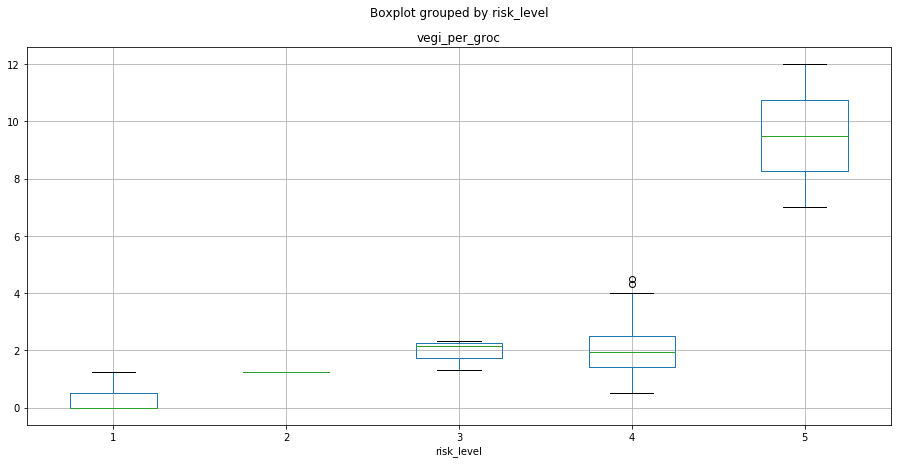

In [152]:
# boxplot to see how the vegi_per_groc ratio overlap per cluster
df_calc2.boxplot(column=['vegi_per_groc'], by='risk_level', figsize=(15,7),grid=True)

(0, 500000)

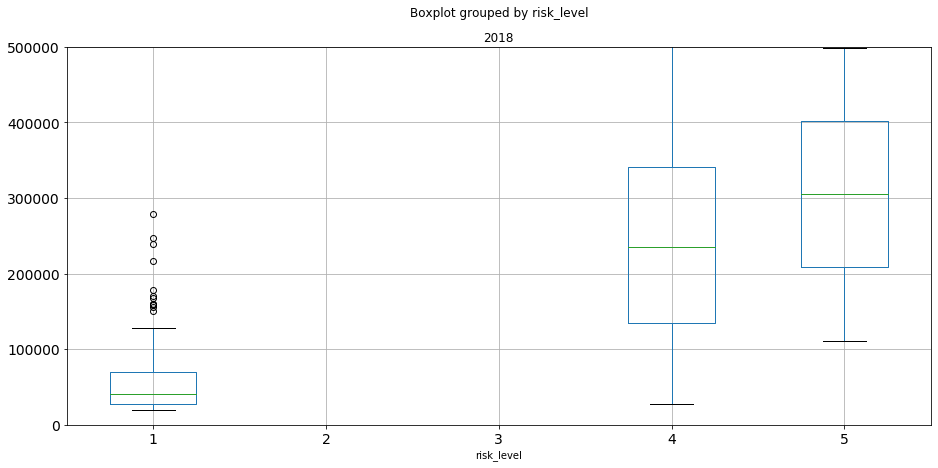

In [154]:
df_calc2.boxplot(column=['2018'], by='risk_level', figsize=(15,7),grid=True,fontsize=14 ).set_ylim(0,500000)

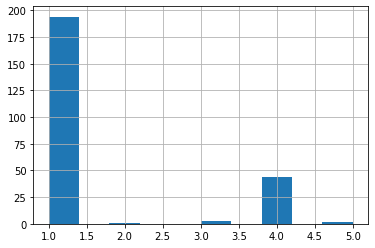

In [155]:
# Histogram
df_calc2['risk_level'].hist()

In [ ]:
#draw the cluster map
location = geolocator.geocode('Germany')
colormap=['green', 'yellow', 'red','blue','orange','magenta']


cities_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6) # generate map centred around the Conrad Hotel

# add a red circle marker to represent the Conrad Hotel
for name,latitude,longitude,radiusp,clusterlabel in zip(df_calc1['latitude'],df_calc1['longitude'],df_calc1['radiusvenue'],df_bc['cluster_label']):
    
    #folium.Circle([latitude,longitude], radius=radiusp, color='green',fill=False).add_to(cities_map)
    folium.CircleMarker(
        [latitude, longitude],
        radius=1,
        color=colormap[clusterlabel],
        popup=name,
        fill = True,
        fill_color = colormap[clusterlabel]).add_to(cities_map)

for coord in centers:
    folium.Circle(
        [coord[0], coord[1]],
        radius=10000,
        color='black',
        fill = True,
        fill_color = 'black').add_to(cities_map)

cities_map

## Merge the risk level data into the City Dataframe df_bc_1
 The df_calc2 Dataframe contains only a subset of the whole cities Dataframe 
  => just because we could not calculate any risk level for cities wich do not have any organic grocery store)
 We have the index which we use as the key to run a left join of the df_bc_1 dataframe
 The empty cells we fill with a "special risk level 6"  which represent "no ". 
 However it is assumed that cities without any existing organic grocery store  will be  better candidates to open a vegetarian restaurant the bigger they are.


In [314]:
#merge the risk level into the City Dataframe df_bc_1
# The calc2 Dataframe contains only a subset of the whole cities Dataframe 
#  => just because we could not calculate any risk level for cities wich do not have any organic grocery store)
# We have the index which we use as the key to run a left join of the df_bc_1 dataframe
# The empty cells we fill with a "special risk level 6"  which represent "no ". 
# However it is assumed that cities without any existing organic grocery store  will be  better candidates to open a vegetarian restaurant the bigger they are.

df_bc_2=df_bc_1.copy()
# df_bc_2 left join on index, include risk_level and vegi_per_groc
df_bc_2=df_bc_2.merge(df_calc2,how='left',left_index=True,right_index=True)

#df_bc_2.dtypes
#df_bc_2[df_bc_2.isnull().any(axis=1) & df_bc_2['count_org_grocs']==0]  #Cross Check.  The result must be empty.
#remove unneeded and redundant features
df_bc_2.drop(columns=['2018_y','cluster_label_y'],inplace=True)
#fill nans for risk_level with value 6
df_bc_2['risk_level'].fillna(6, inplace=True)
df_bc_2['vegi_per_groc'].fillna(99,inplace=True)
#rename 2018_x to '2018', cluster_label_x to cluster_label
df_bc_2.rename(columns={'2018_x':'2018', 'cluster_label_x':'cluster_label'},inplace=True)
df_bc_2.head()
#df_bc_2[df_bc_2.isnull().any(axis=1)]
#df_bc_2[df_bc_2['risk_level']==6]

,city_index,Name,2018,Bundesland,latitude,longitude,radius,radiusvenue,count_vegi_rest,count_org_grocs,cluster_label,vegi_per_groc,risk_level
0,0,Berlin,3644826,Berlin,52.517037,13.388860,7687.329022,3000.000000,49.0,39.0,4,1.256410,2.0
1,1,Hamburg,1841179,Hamburg,53.543764,10.009913,8193.936307,3000.000000,26.0,12.0,1,2.166667,3.0
2,2,München,1471508,Bayern,48.137108,11.575382,4148.926428,3000.000000,47.0,36.0,1,1.305556,3.0
3,3,Köln,1085664,Nordrhein-Westfalen,50.938361,6.959974,4344.712847,3000.000000,42.0,18.0,1,2.333333,3.0
4,4,Frankfurt am Main,753056,Hessen,50.110644,8.682092,2839.296275,2839.296275,25.0,15.0,3,1.666667,4.0


## Final result:
- A Map with colored circles which represents the risk levels. Low risk levels such as 1 will be most suitable to open a Vegetarian Restaurant. Marked as green 
- The other risk levels will be colored yellow, orange, red, purple. 
- Cities where we could not calculate the risk level due to missing organic grocery stores are colored white.
- A Table showing the lowest risk level 1 sorted by population (descending)
- A Table showing the risk level 6 sorted by population (limited to 50)

In [321]:
# Create the map
import folium
import geopandas as gpd
from folium.map import Layer, FeatureGroup,LayerControl,Marker
from folium.plugins import MarkerCluster,FeatureGroupSubGroup,Fullscreen
#get the german borders from the shapefile (stored locally)
shape=gpd.read_file('./german_border/VG1000_STA.shp')

location = geolocator.geocode('Germany')


cities_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6,figsize=(20,20)) # generate map centred around the Conrad Hotel
# Add tiles
folium.TileLayer(tiles="Stamen Toner").add_to(cities_map)


cm=['grey','green','yellow','orange','red','purple','white']
lgd_txt = '<span style="color: {col};">{txt}</span>'    
# create marker clusters (at certain zoom level this shows one point with numbers instead individual points)

markercluster=MarkerCluster(control = False).add_to(cities_map)
#markercluster.add_to(cities_map)
markercluster1=MarkerCluster(control = False).add_to(cities_map)

#FeatureGroupSubGroup(marker_cluster, name = event, control = True, show = True)

# create feature groups
fg=[0 for i in range(0,10)]
#CreateFeatureGroup as this is not under markercluster control (does not work as expected)
#fg[0] = FeatureGroup(name= lgd_txt.format( txt= 'Venue search area', col= cm[0]),control=True,show=False)
#FeatureGroupSubGroup works well together with Markercluster

fg[1]= FeatureGroupSubGroup(markercluster1,name='Risk Level 1, Most Suitable City')
fg[2]= FeatureGroupSubGroup(markercluster1,name='Risk Level 2')
fg[3]= FeatureGroupSubGroup(markercluster1,name='Risk Level 3')
fg[4]= FeatureGroupSubGroup(markercluster1,name='Risk Level 4')
fg[5]= FeatureGroupSubGroup(markercluster1,name='Risk Level 5, Least Suitable City')
fg[6]= FeatureGroupSubGroup(markercluster1,name='Risk Level Unkown')
fg[7] = FeatureGroupSubGroup(markercluster,name='Organic Grocery Stores',overlay=True) 
fg[8] = FeatureGroupSubGroup(markercluster,name='Vegetarian Restaurants') 


fg[9] = FeatureGroupSubGroup(markercluster,name= lgd_txt.format(txt='German Border', col='blue'),control=True,show=False)

fg[9].add_child(folium.GeoJson(shape))  # Add German Borders to the map (the origin is a "shapefile"


# 

# create circles with radius according the foursquare search area, color them according risk level.
for name,latitude,longitude,radiusp,population,popcat,risk_level in zip(df_bc_2['Name'],df_bc_2['latitude'],df_bc_2['longitude'],df_bc_2['radiusvenue'],df_bc_2['2018'],df_bc['pop_cat'],df_bc_2['risk_level']):
    risk_level=int(risk_level)
    folium.Circle([latitude,longitude], radius=radiusp, color=cm[risk_level],fill=True).add_to(fg[risk_level])
    #fg[0].add_child(ra)



#Organic groceries => add to fg[7]
for name,latitude,longitude,address in zip(df_organic_groceries['name'], df_organic_groceries['location.lat'],df_organic_groceries['location.lng'],df_organic_groceries['location.formattedAddress']):
    address=',\n'.join(address)
    fname=name+'\n'+address
    folium.Marker(
        [latitude, longitude],
        name='Organic Grocery Store',
        popup=fname,
        icon=folium.Icon(color="green",icon="shopping-bag", prefix='fa')).add_to(fg[7])


#Vegetarian restaurants => add to fg[8]    
for name,latitude,longitude, address in zip(df_vegi_restaurants['name'], df_vegi_restaurants['location.lat'],df_vegi_restaurants['location.lng'],df_vegi_restaurants['location.formattedAddress']):
    address=',\n'.join(address)
    name=name+'\n'+address
    fg[8].add_child(folium.Marker(
        [latitude, longitude],
        popup=name,
       icon=folium.Icon(color="orange",icon="utensil", prefix="fa")))
    
    
for i in fg[1:]:
    i.add_to(cities_map)
  


    
folium.map.LayerControl('topleft', collapsed= False).add_to(cities_map)    
Fullscreen().add_to(cities_map) # Button to activate Fullscreen mode
cities_map

In [326]:
# Create the map
import folium
import geopandas as gpd
from folium.map import Layer, FeatureGroup,LayerControl,Marker
from folium.plugins import MarkerCluster,FeatureGroupSubGroup,Fullscreen
#get the german borders from the shapefile (stored locally)
shape=gpd.read_file('./german_border/VG1000_STA.shp')

location = geolocator.geocode('Germany')


cities_map = folium.Map(location=[location.latitude, location.longitude], zoom_start=6,figsize=(20,20)) # generate map centred around the Conrad Hotel
# Add tiles
folium.TileLayer(tiles="Stamen Toner").add_to(cities_map)


cm=['grey','green','yellow','orange','red','purple','white']
lgd_txt = '<span style="color: {col};">{txt}</span>'    
# create marker clusters (at certain zoom level this shows one point with numbers instead individual points)

markercluster=MarkerCluster(control = False).add_to(cities_map)
#markercluster.add_to(cities_map)
markercluster1=MarkerCluster(control = False).add_to(cities_map)

#FeatureGroupSubGroup(marker_cluster, name = event, control = True, show = True)

# create feature groups
fg=[0 for i in range(0,10)]
#CreateFeatureGroup as this is not under markercluster control (does not work as expected)
#fg[0] = FeatureGroup(name= lgd_txt.format( txt= 'Venue search area', col= cm[0]),control=True,show=False)
#FeatureGroupSubGroup works well together with Markercluster

fg[1]= FeatureGroup(name='Risk Level 1, Most Suitable City')
fg[2]= FeatureGroup(name='Risk Level 2')
fg[3]= FeatureGroup(name='Risk Level 3')
fg[4]= FeatureGroup(name='Risk Level 4')
fg[5]= FeatureGroup(name='Risk Level 5, Least Suitable City')
fg[6]= FeatureGroup(name='Risk Level Unkown')
fg[7] = FeatureGroup(name='Organic Grocery Stores',overlay=True) 
fg[8] = FeatureGroup(name='Vegetarian Restaurants',overlay=True) 


fg[9] = FeatureGroupSubGroup(markercluster,name= lgd_txt.format(txt='German Border', col='blue'),control=True,show=False)

fg[9].add_child(folium.GeoJson(shape))  # Add German Borders to the map (the origin is a "shapefile"


# 

# create circles with radius according the foursquare search area, color them according risk level.
for name,latitude,longitude,radiusp,population,popcat,risk_level in zip(df_bc_2['Name'],df_bc_2['latitude'],df_bc_2['longitude'],df_bc_2['radiusvenue'],df_bc_2['2018'],df_bc['pop_cat'],df_bc_2['risk_level']):
    risk_level=int(risk_level)
    folium.Circle([latitude,longitude], radius=radiusp, color=cm[risk_level],fill=True).add_to(fg[risk_level])
    #fg[0].add_child(ra)



#Organic groceries => add to fg[7]
for name,latitude,longitude,address in zip(df_organic_groceries['name'], df_organic_groceries['location.lat'],df_organic_groceries['location.lng'],df_organic_groceries['location.formattedAddress']):
    address=',\n'.join(address)
    fname=name+'\n'+address
    folium.Marker(
        [latitude, longitude],
        name='Organic Grocery Store',
        popup=fname,
        icon=folium.Icon(color="green",icon="shopping-bag", prefix='fa')).add_to(fg[7])


#Vegetarian restaurants => add to fg[8]    
for name,latitude,longitude, address in zip(df_vegi_restaurants['name'], df_vegi_restaurants['location.lat'],df_vegi_restaurants['location.lng'],df_vegi_restaurants['location.formattedAddress']):
    address=',\n'.join(address)
    name=name+'\n'+address
    fg[8].add_child(folium.Marker(
        [latitude, longitude],
        popup=name,
       icon=folium.Icon(color="orange",icon="utensil", prefix="fa")))
    
    
for i in fg[1:]:
    i.add_to(cities_map)
  


    
folium.map.LayerControl('topleft', collapsed= False).add_to(cities_map)    
Fullscreen().add_to(cities_map) # Button to activate Fullscreen mode
cities_map

In [355]:
df_tmp=df_bc_2.sort_values(['vegi_per_groc','risk_level','2018'],ascending=[True,True,False]).head(20)
df_tmp.rename(columns={'2018':'Population', 'Bundesland':'Federal State'},inplace=True)
df_tmp.drop(['radius','radiusvenue','cluster_label','city_index'],axis=1,inplace=True)
df_tmp

,Name,Population,Federal State,latitude,longitude,count_vegi_rest,count_org_grocs,vegi_per_groc,risk_level
52,Herne,156374,Nordrhein-Westfalen,51.538039,7.219985,0.0,1.0,0.0,1.0
63,Wolfsburg,124151,Niedersachsen,52.420559,10.786168,0.0,1.0,0.0,1.0
66,Reutlingen,115966,Baden-Württemberg,48.491951,9.211414,0.0,2.0,0.0,1.0
70,Bergisch Gladbach,111966,Nordrhein-Westfalen,50.992930,7.127738,0.0,2.0,0.0,1.0
73,Remscheid,110994,Nordrhein-Westfalen,51.179871,7.194354,0.0,2.0,0.0,1.0
83,Hanau,96023,Hessen,50.133554,8.916818,0.0,1.0,0.0,1.0
85,Gera,94152,Thüringen,50.877230,12.079621,0.0,2.0,0.0,1.0
88,Iserlohn,92666,Nordrhein-Westfalen,51.374678,7.699971,0.0,1.0,0.0,1.0
89,Düren,90733,Nordrhein-Westfalen,50.803168,6.482081,0.0,1.0,0.0,1.0
95,Lünen,86449,Nordrhein-Westfalen,51.614248,7.522809,0.0,1.0,0.0,1.0


In [388]:
df_tmp=df_bc_2.copy()
df_tmp['pop_cat']=df_bc['pop_cat'].copy()
df_tmp
pd.pivot_table(df_tmp, values='Name', index=['risk_level'],columns=['pop_cat'], aggfunc='count',margins=True)

pop_cat,1,2,3,4,All
risk_level,,,,,
1.0,167.0,27.0,NaN,NaN,194
2.0,NaN,NaN,NaN,1.0,1
3.0,NaN,NaN,NaN,3.0,3
4.0,9.0,25.0,10.0,NaN,44
5.0,NaN,2.0,NaN,NaN,2
6.0,443.0,13.0,NaN,NaN,456
All,619.0,67.0,10.0,4.0,700


In [391]:
pd.crosstab(df_tmp, values='Name', index=['risk_level'],columns=['pop_cat'], aggfunc='count',margins=True)

TypeError: crosstab() got multiple values for argument 'index'